# Data preparetion

### Import

In [2]:
#Load the required libraries
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import seaborn as sns

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.model_selection as ms
from sklearn.svm import SVR
from sklearn.model_selection  import train_test_split
from sklearn.preprocessing import OneHotEncoder,StandardScaler
from pandas.plotting import scatter_matrix
from sklearn.metrics import mean_squared_error
from math import sqrt

## Confusion Matrix
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report
from sklearn.metrics import accuracy_score,f1_score,roc_auc_score, recall_score
from sklearn.model_selection import cross_val_score, KFold, cross_val_predict
from sklearn.metrics import precision_recall_curve, average_precision_score,roc_curve, auc, precision_score

In [3]:
# feature selection
import statsmodels.api as sm
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance
import shap
import category_encoders as ce

import xgboost as xgb

In [4]:
## roc & auc
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc  ###计算roc和auc

In [5]:
# Tree View
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

In [6]:
## modelling
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

In [7]:
## GridSearch
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

In [8]:
## Model Explaination
### Permutation Importance
import eli5
from eli5.sklearn import PermutationImportance
### SHAP
import shap

In [11]:
import os
os.getcwd()

'/Users/lijiaze/Desktop/2022-2/CITS5553/model/data'

In [10]:
os.chdir('/Users/lijiaze/Desktop/2022-2/CITS5553/model/data/')

### Load data

#### load whole data

In [12]:
#Load the data
df = pd.read_csv("wba_data_CLEAN.csv")

#View the data
df.head()

,Unnamed: 0,Subject,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,...,f(6168.8433),f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000)
0,0,8,0,9.333333,1.08,-189.0,0.52,1,3.0,10.0,...,0.5370,0.4869,0.4301,0.4080,0.3804,0.3291,0.2951,0.2530,0.2282,0.2003
1,1,22,0,9.500000,1.28,-49.0,1.28,0,7.0,4.0,...,0.2636,0.2578,0.2443,0.2549,0.2604,0.2397,0.2299,0.2048,0.1917,0.1659
2,2,24,1,9.833333,1.26,-27.0,0.87,0,9.0,12.0,...,0.4269,0.4142,0.3910,0.3799,0.3740,0.3536,0.3473,0.3237,0.3056,0.2881
3,3,31,0,9.916667,0.64,-8.0,0.60,0,13.0,9.0,...,0.0077,0.0123,0.0066,0.0000,0.0126,0.0231,0.0405,0.0401,0.0391,0.0258
4,4,42,0,7.916667,0.92,-17.0,1.65,0,7.0,0.0,...,0.2332,0.2216,0.2228,0.2653,0.2596,0.2576,0.2838,0.3598,0.3953,0.3642


In [13]:
# Remove 'Unnamed: 0' and subject column
wba_data = df.drop(["Unnamed: 0", "Subject"], axis=1)

wba_data.head()

,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,OAE2.8,...,f(6168.8433),f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000)
0,0,9.333333,1.08,-189.0,0.52,1,3.0,10.0,18.0,14.0,...,0.5370,0.4869,0.4301,0.4080,0.3804,0.3291,0.2951,0.2530,0.2282,0.2003
1,0,9.500000,1.28,-49.0,1.28,0,7.0,4.0,9.0,5.0,...,0.2636,0.2578,0.2443,0.2549,0.2604,0.2397,0.2299,0.2048,0.1917,0.1659
2,1,9.833333,1.26,-27.0,0.87,0,9.0,12.0,8.0,12.0,...,0.4269,0.4142,0.3910,0.3799,0.3740,0.3536,0.3473,0.3237,0.3056,0.2881
3,0,9.916667,0.64,-8.0,0.60,0,13.0,9.0,13.0,11.0,...,0.0077,0.0123,0.0066,0.0000,0.0126,0.0231,0.0405,0.0401,0.0391,0.0258
4,0,7.916667,0.92,-17.0,1.65,0,7.0,0.0,2.0,12.0,...,0.2332,0.2216,0.2228,0.2653,0.2596,0.2576,0.2838,0.3598,0.3953,0.3642


In [14]:
# freqs = [f for f in features if f[:2] == "f("]
frequency = wba_data.iloc[:,14:138]
frequency_list = list(frequency.columns)
frequency_list[0:10]

['f(226.0000)',
 'f(257.3256)',
 'f(280.6155)',
 'f(297.3018)',
 'f(324.2099)',
 'f(343.4884)',
 'f(363.9133)',
 'f(385.5527)',
 'f(408.4789)',
 'f(432.7683)']

#### load original train and test data

In [15]:
#Load the data
X_train = pd.read_csv("X_train.csv")
X_test = pd.read_csv("X_test.csv")
y_train = pd.read_csv("y_train.csv")
y_test = pd.read_csv("y_test.csv")

#View the data
X_train.head()

,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,OAE2.8,...,f(6168.8433),f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000)
0,1,8.583333,0.89,-151.0,2.53,1,0.0,5.0,9.2,11.7,...,0.3955,0.3583,0.2997,0.2709,0.2544,0.1956,0.1648,0.1158,0.1083,0.0542
1,1,9.833333,0.81,-63.0,1.32,0,8.1,20.8,14.7,6.9,...,0.4592,0.4006,0.3508,0.3381,0.2983,0.2789,0.2655,0.3118,0.3039,0.3022
2,0,10.083333,1.50,-28.0,0.56,0,10.4,15.4,15.6,9.9,...,0.2600,0.2409,0.2002,0.2064,0.2190,0.1961,0.2076,0.1994,0.2084,0.1099
3,1,8.666667,1.15,3.0,1.07,0,10.6,15.1,15.0,7.8,...,0.5128,0.4605,0.4126,0.4001,0.3634,0.3378,0.3084,0.3156,0.3042,0.2912
4,1,8.583333,1.03,-10.0,0.43,0,3.7,11.5,7.4,5.7,...,0.0000,0.0034,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000


#### load train and test sets after oversampling

In [16]:
#Load the data
X_train_over_large = pd.read_csv("large/Oversampling_Large/X_train_over.csv")
X_test_over_large = pd.read_csv("large/Oversampling_Large/X_test_over.csv")
y_train_over_large = pd.read_csv("large/Oversampling_Large/y_train_over.csv")
y_test_over_large = pd.read_csv("large/Oversampling_Large/y_test_over.csv")

#View the data
X_train_over_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,5299,1,9.416667,0.93,-276.0,0.74,1,7.6,12.5,16.9,...,0.3518,0.3705,0.3571,0.3537,0.3253,0.2939,0.2267,0.2009,0.1506,5299
1,4630,1,9.833333,1.26,-43.0,0.96,0,6.0,12.0,8.0,...,0.2289,0.2080,0.2027,0.2397,0.2848,0.3512,0.4027,0.4698,0.5473,4630
2,7124,0,8.916667,0.91,-291.0,0.62,1,2.8,11.9,15.5,...,0.3683,0.3139,0.2374,0.1995,0.1636,0.1545,0.1399,0.1475,0.1596,7124
3,6631,0,8.583333,1.07,7.0,0.89,0,10.9,0.4,6.7,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,6631
4,2604,1,10.166667,0.96,6.0,0.51,0,15.0,12.0,15.0,...,0.0480,0.0249,0.0260,0.0518,0.0420,0.0440,0.0189,0.0228,0.0000,2604


In [17]:
y_train_over_large = y_train_over_large.loc[:,['OverallPoF']]
y_train_over_large.head()

,OverallPoF
0,1
1,0
2,1
3,1
4,0


In [18]:
y_test_over_large = y_test_over_large.loc[:,['OverallPoF']]
y_test_over_large.head() 

,OverallPoF
0,0
1,1
2,0
3,0
4,0


#### load train and test sets after SMOTE

In [19]:
#Load the data
X_train_smote_large = pd.read_csv("large/Smote_Large/X_train_smote.csv")
X_test_smote_large = pd.read_csv("large/Smote_Large/X_test_smote.csv")
y_train_smote_large = pd.read_csv("large/Smote_Large/y_train_smote.csv")
y_test_smote_large = pd.read_csv("large/Smote_Large/y_test_smote.csv")

#View the data
X_train_smote_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,5299,0,9.488345,1.308848,-289.942410,0.392962,1,-1.983546,0.090498,5.016454,...,0.239612,0.208967,0.198652,0.197264,0.182982,0.180403,0.161424,0.149762,0.131750,5299
1,4630,0,8.329579,0.845676,-22.969964,0.544024,0,4.507509,18.086484,13.092180,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4630
2,7124,0,9.191612,0.920998,-282.751648,0.685987,1,5.439473,12.229934,16.269846,...,0.359227,0.345024,0.303222,0.284293,0.252517,0.231155,0.187630,0.176864,0.154651,7124
3,6631,0,8.462231,0.993812,-120.474751,0.626834,1,6.743916,9.804346,3.044619,...,0.077931,0.044569,0.036674,0.052039,0.046861,0.057982,0.050766,0.067965,0.060894,6631
4,2604,1,9.964026,0.810123,1.121584,0.467022,0,13.183881,15.481149,9.783881,...,0.168985,0.123954,0.125818,0.136950,0.109801,0.105816,0.079430,0.093070,0.056131,2604


In [20]:
y_train_smote_large = y_train_smote_large.loc[:,['OverallPoF']]
y_train_smote_large.head()

,OverallPoF
0,1
1,0
2,1
3,1
4,0


In [21]:
y_test_smote_large = y_test_smote_large.loc[:,['OverallPoF']]
y_test_smote_large.head()

,OverallPoF
0,0
1,1
2,0
3,0
4,0


#### load train and test sets after SVM SMOTE (large)

In [22]:
#Load the data
X_train_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/X_train_svmsmote.csv")
X_test_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/X_test_svmsmote.csv")
y_train_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/y_train_svmsmote.csv")
y_test_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/y_test_svmsmote.csv")

#View the data
X_train_svmsmote_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,3526,0,7.671420,1.788495,-26.057037,0.715388,0,-1.883375,5.264805,3.368931,...,0.328155,0.342032,0.364087,0.407503,0.438861,0.493819,0.538866,0.564331,0.612743,3526
1,4948,1,8.416667,0.991337,-5.133655,0.424957,0,-1.100000,-3.776305,-1.579710,...,0.612860,0.560013,0.534799,0.492017,0.472529,0.453393,0.437095,0.423667,0.401722,4948
2,4378,0,7.714042,1.781300,-26.691790,0.714315,0,-1.325330,5.921238,3.664388,...,0.331551,0.341106,0.358729,0.398328,0.422852,0.471688,0.509057,0.533475,0.573287,4378
3,4680,0,8.082248,0.942708,-13.593746,1.334921,0,6.403905,1.845054,3.646356,...,0.238461,0.224106,0.245572,0.238141,0.227597,0.243436,0.288155,0.313294,0.281400,4680
4,8319,1,9.562745,0.958485,-274.685295,0.788206,1,8.684632,13.135441,17.743602,...,0.374950,0.400749,0.387185,0.383916,0.357697,0.325847,0.251537,0.222910,0.167100,8319


In [23]:
y_train_svmsmote_large = y_train_svmsmote_large.loc[:,['OverallPoF']]
y_train_svmsmote_large.head()

,OverallPoF
0,0
1,1
2,0
3,1
4,1


In [24]:
y_test_svmsmote_large = y_test_svmsmote_large.loc[:,['OverallPoF']]
y_test_svmsmote_large.head()

,OverallPoF
0,1
1,0
2,1
3,0
4,0


#### load train and test sets after Adasyn (large)

In [25]:
#Load the data
X_train_adasyn_large = pd.read_csv("large/Adasyn_Large/X_train_adasyn.csv")
X_test_adasyn_large = pd.read_csv("large/Adasyn_Large/X_test_adasyn.csv")
y_train_adasyn_large = pd.read_csv("large/Adasyn_Large/y_train_adasyn.csv")
y_test_adasyn_large = pd.read_csv("large/Adasyn_Large/y_test_adasyn.csv")

#View the data
X_train_adasyn_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,3102,0,9.377737,1.061538,0.981234,0.824672,0,8.106568,11.147284,9.783679,...,0.640833,0.584083,0.539227,0.495584,0.438291,0.397680,0.349746,0.327047,0.297556,3102
1,1752,0,9.246811,0.781131,-94.307823,0.715757,0,13.173328,17.731009,12.399887,...,0.051371,0.044253,0.038635,0.034667,0.030675,0.029521,0.027053,0.024445,0.022184,1752
2,49,1,8.666667,0.860000,-15.000000,0.470000,0,16.000000,10.500000,13.700000,...,0.051100,0.023500,0.019100,0.038700,0.034300,0.045800,0.034800,0.045400,0.019300,49
3,4055,0,9.333333,0.698682,-94.413908,0.632417,0,14.300729,19.293046,12.350926,...,0.024534,0.019751,0.015344,0.014418,0.013914,0.016118,0.018181,0.020290,0.025132,4055
4,2319,0,9.224798,1.391833,-87.460485,1.050653,0,4.539515,5.434141,14.434141,...,0.216785,0.186747,0.163039,0.146292,0.129448,0.124579,0.114161,0.103159,0.093617,2319


In [26]:
y_train_adasyn_large = y_train_adasyn_large.loc[:,['OverallPoF']]
y_train_adasyn_large.head()

,OverallPoF
0,0
1,0
2,0
3,0
4,0


In [27]:
y_test_adasyn_large = y_test_adasyn_large.loc[:,['OverallPoF']]
y_test_adasyn_large.head()

,OverallPoF
0,1
1,1
2,1
3,1
4,1


### Visualization function

In [28]:
def assess_freqs(wba_data, freq_cols, selected, title = "Selected Frequencies"):
    """
    wba_data: Full dataset
    freq_cols: List of all frequency column names
    selected: List of selected frequencies
    """

    # Creating melted dataframe (long format) for plotting
    overall_pof_df = wba_data[['OverallPoF'] + freq_cols]
    overall_pof_df = overall_pof_df.replace({'OverallPoF':{0: 'Pass', 1: 'Fail'}})
    overall_pof_df = overall_pof_df.groupby('OverallPoF').mean()
    overall_pof_df = overall_pof_df.melt(ignore_index=False)
    overall_pof_df = overall_pof_df.reset_index()

    # Plotting
    ax = sns.pointplot(x='variable', y='value', hue='OverallPoF', data=overall_pof_df)

    # Adding vertical lines at selected frequencies
    position = 0
    for freq in freq_cols:
        if freq in selected:
            ax.axvline(x=position, ls='--', color='red')
        position += 1

    sns.set(rc={'figure.figsize':(20,10)})

    # Rotate x-axis labels
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right")

    ax.set(title = title)

    # Show only every 2 tick labels on x-axis
    # plt.setp(ax.get_xticklabels()[::2], visible=False)

    plt.tight_layout()
    plt.show();


### Only use the feature after feature selecting

从feature selection.ipynb文件中我们就已经得到用第四种方法（xgboost）来进行feature selection得到的结果最好，所以这里我们直接使用第四种方法来筛选frequencies，最终的到20个frequencies

In [29]:
frequency_train = X_train.iloc[:,13:138]
frequency_test = X_test.iloc[:,13:138]

In [30]:
encoder = ce.LeaveOneOutEncoder(return_df=True)
X_train_loo = encoder.fit_transform(frequency_train, y_train)
X_test_loo = encoder.transform(frequency_test)

In [31]:
fs_model = xgb.XGBRegressor(n_estimators=500, max_depth=5, eta=0.05)
fs_model.fit(X_train_loo, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False, eta=0.05,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.0500000007, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=5, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=500, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0, ...)

Text(0.5, 1.0, 'Feature Importance')

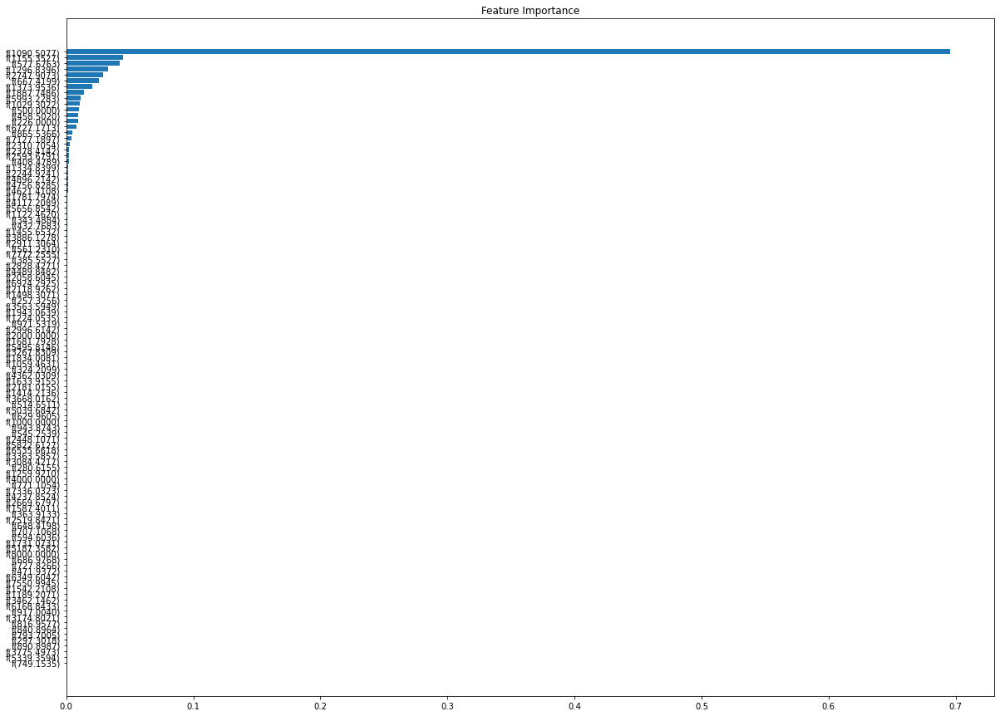

In [32]:
feature_importance = fs_model.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(20, 15))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(frequency_test.columns)[sorted_idx])
plt.title('Feature Importance')

In [33]:
sorted_idx=sorted_idx[-20:]
f_list=list(np.array(frequency_test.columns)[sorted_idx])
f_list

['f(408.4789)',
 'f(2593.6791)',
 'f(2378.4142)',
 'f(2310.7054)',
 'f(7127.1897)',
 'f(865.5366)',
 'f(6727.1713)',
 'f(226.0000)',
 'f(458.5020)',
 'f(500.0000)',
 'f(1029.3022)',
 'f(5993.2283)',
 'f(1887.7486)',
 'f(1373.9536)',
 'f(667.4199)',
 'f(2747.9073)',
 'f(1296.8396)',
 'f(577.6763)',
 'f(1155.3527)',
 'f(1090.5077)']

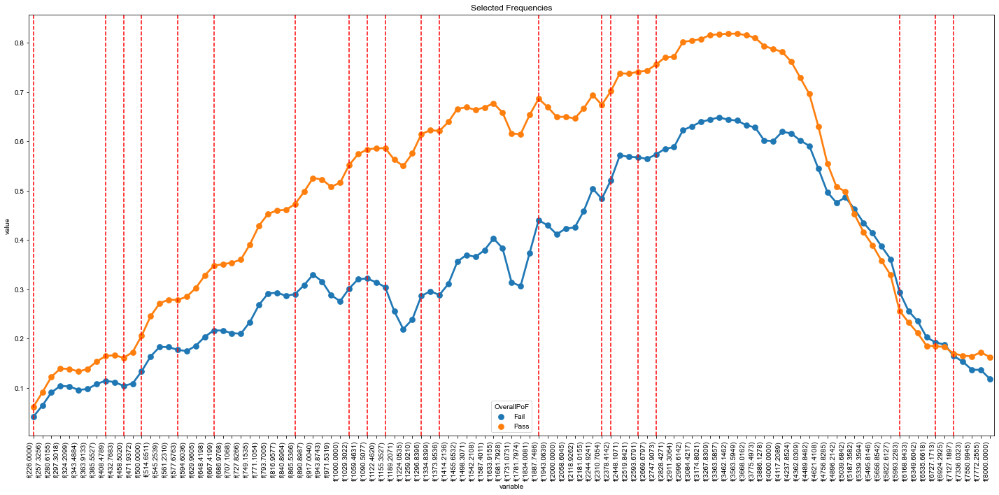

In [34]:
fig = plt.figure(figsize=(20, 10))
assess_freqs(wba_data, frequency_list, f_list)

现在我们得到了f_list，也就是我们将要选择的相关性最高的前20个频率。

### Train and teat sets after feature selection

'TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4'

#### Final training and testing data

In [36]:
# original
X_train = pd.concat([X_train.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_train[f_list]],axis=1)
X_test = pd.concat([X_test.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_test[f_list]],axis=1)
# X_train = X_train[f_list]
# X_test = X_test[f_list]

In [38]:
# after oversampling
X_train_over_large = pd.concat([X_train_over_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_train_over_large[f_list]],axis=1)
X_test_over_large = pd.concat([X_test_over_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_test_over_large[f_list]],axis=1)

In [39]:
# after SMOTE
X_train_smote_large = pd.concat([X_train_smote_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_train_smote_large[f_list]],axis=1)
X_test_smote_large = pd.concat([X_test_smote_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_test_smote_large[f_list]],axis=1)

In [40]:
# after SVM SMOTE
X_train_svmsmote_large = pd.concat([X_train_svmsmote_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_train_svmsmote_large[f_list]],axis=1)
X_test_svmsmote_large = pd.concat([X_test_svmsmote_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_test_svmsmote_large[f_list]],axis=1)

In [41]:
# after Adasyn
X_train_adasyn_large = pd.concat([X_train_adasyn_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_train_adasyn_large[f_list]],axis=1)
X_test_adasyn_large = pd.concat([X_test_adasyn_large.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']], X_test_adasyn_large[f_list]],axis=1)

#### view data

In [46]:
X_train.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,-151.0,1,0.0,5.0,9.2,11.7,5.9,0.0538,0.6712,0.4938,...,0.2009,0.4621,0.3844,0.1865,0.1433,0.7555,0.1841,0.0907,0.2103,0.2344
1,-63.0,0,8.1,20.8,14.7,6.9,8.3,0.0689,0.8478,0.7828,...,0.4167,0.4768,0.8366,0.4787,0.2103,0.8399,0.5119,0.1542,0.4387,0.4141
2,-28.0,0,10.4,15.4,15.6,9.9,10.7,0.2371,0.6491,0.6827,...,0.4437,0.2779,0.5040,0.5173,0.3734,0.6188,0.5211,0.3276,0.5004,0.5038
3,3.0,0,10.6,15.1,15.0,7.8,4.0,0.1050,0.6001,0.6846,...,0.5456,0.5285,0.6283,0.6200,0.2664,0.5698,0.5979,0.2041,0.5736,0.5528
4,-10.0,0,3.7,11.5,7.4,5.7,8.5,0.1336,0.4592,0.3856,...,0.5451,0.0026,0.4929,0.5128,0.3649,0.4908,0.5497,0.2672,0.5757,0.5824


In [47]:
X_test.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,-11.0,0,11.5,27.4,9.6,6.0,9.2,0.2284,0.6784,0.6252,...,0.9315,0.3433,0.5636,0.7442,0.5310,0.7210,0.7940,0.4128,0.9246,0.9544
1,-8.0,0,14.0,17.6,17.7,7.6,6.2,0.2304,0.4966,0.5483,...,0.4562,0.2287,0.6087,0.5521,0.3515,0.4621,0.5481,0.3113,0.5132,0.5049
2,-16.0,0,16.2,9.8,8.8,17.2,23.1,0.1865,0.8640,0.7116,...,0.8540,0.1569,0.6011,0.7677,0.4840,0.9162,0.7790,0.3650,0.8214,0.8624
3,-34.0,0,15.1,20.2,17.8,7.4,7.0,0.1742,0.7097,0.7218,...,0.5060,0.5813,0.8344,0.7748,0.3371,0.6885,0.6994,0.2778,0.5813,0.5557
4,-6.0,0,5.0,5.0,12.0,13.0,11.0,0.2256,0.9472,0.8525,...,0.6774,0.3439,0.7051,0.6109,0.3775,0.9607,0.6136,0.3198,0.6399,0.6792


In [48]:
X_train_over_large.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,-276.0,1,7.6,12.5,16.9,14.2,19.0,0.0927,0.4960,0.3840,...,0.2117,0.2971,0.3381,0.1793,0.1990,0.5153,0.1825,0.1611,0.2151,0.2356
1,-43.0,0,6.0,12.0,8.0,3.0,7.0,0.1454,0.7390,0.7193,...,0.5153,0.2819,0.8085,0.6362,0.3281,0.7129,0.5994,0.2427,0.5799,0.5716
2,-291.0,1,2.8,11.9,15.5,6.0,0.7,0.0794,0.7436,0.6379,...,0.2435,0.4568,0.5737,0.2568,0.1890,0.8150,0.2479,0.1369,0.2588,0.2755
3,7.0,0,10.9,0.4,6.7,11.1,4.8,0.2341,0.9919,0.9393,...,0.6705,0.0000,0.8368,0.8065,0.4516,0.9912,0.8317,0.3946,0.7505,0.7091
4,6.0,0,15.0,12.0,15.0,11.0,13.0,0.1163,0.8194,0.6787,...,0.4471,0.0440,0.7271,0.5120,0.2808,0.8311,0.5035,0.2087,0.4954,0.4882


In [49]:
X_test_over_large.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,1.0,0,8.0,11.0,6.0,12.0,9.0,0.3525,0.5581,0.5354,...,0.7914,0.3117,0.8115,0.7321,0.5731,0.5695,0.7259,0.5146,0.7284,0.7652
1,-117.0,1,8.3,11.3,3.8,6.5,11.9,0.1137,0.6589,0.5253,...,0.3417,0.1810,0.4998,0.3813,0.2636,0.7030,0.3718,0.2109,0.3676,0.3686
2,-18.0,0,8.0,19.3,24.3,18.6,6.8,0.1313,0.5824,0.5290,...,0.6945,0.4104,0.5632,0.8269,0.3104,0.7009,0.8347,0.2602,0.7845,0.7241
3,-31.0,0,7.0,9.0,8.0,13.0,10.0,0.1690,0.9498,0.9053,...,0.7872,0.0806,0.7858,0.8994,0.3635,0.9600,0.9105,0.2856,0.8596,0.8175
4,-27.0,0,-0.9,6.1,3.8,6.0,8.5,0.3351,0.4943,0.4481,...,0.5841,0.2957,0.5173,0.6100,0.4714,0.4698,0.6066,0.4499,0.6321,0.6269


In [50]:
X_train_smote_large.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,-289.942410,1,-1.983546,0.090498,5.016454,2.024681,-0.016454,0.214154,0.334547,0.389703,...,0.253388,0.276110,0.245550,0.042039,0.288133,0.303605,0.067992,0.287102,0.179317,0.250080
1,-22.969964,0,4.507509,18.086484,13.092180,9.075091,10.558260,0.185861,0.721965,0.750568,...,0.643929,0.000000,0.807130,0.810505,0.417664,0.742859,0.763702,0.334702,0.656108,0.668966
2,-282.751648,1,5.439473,12.229934,16.269846,10.509099,10.762990,0.086714,0.607447,0.498283,...,0.226013,0.368983,0.444146,0.214184,0.194499,0.650198,0.211937,0.150207,0.234770,0.253559
3,-120.474751,1,6.743916,9.804346,3.044619,5.925911,9.951118,0.113776,0.660955,0.541495,...,0.328964,0.153655,0.534306,0.372976,0.255155,0.695975,0.360076,0.204540,0.356148,0.358825
4,1.121584,0,13.183881,15.481149,9.783881,8.010931,4.431010,0.201181,0.643153,0.635582,...,0.435078,0.226420,0.766223,0.490819,0.417534,0.628932,0.482365,0.345876,0.478598,0.480594


In [51]:
X_test_smote_large.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,-95.363692,0,14.160554,18.733292,12.115200,10.560677,14.566462,0.063370,0.932548,0.956849,...,0.289103,0.086680,0.834861,0.434959,0.194828,0.873704,0.406208,0.132343,0.338130,0.328657
1,-186.513214,1,8.467101,5.680315,3.672425,8.722367,8.172386,0.048726,0.770589,0.699027,...,0.211597,0.387645,0.401832,0.207630,0.128977,0.766470,0.206309,0.081672,0.226222,0.242350
2,-47.744253,0,5.325671,8.162835,14.488506,16.232759,8.488506,0.086168,0.828373,0.797865,...,0.396828,0.276550,0.751607,0.517239,0.214199,0.837372,0.487346,0.152995,0.442131,0.450352
3,-14.201020,0,11.614650,14.314650,8.842930,16.032026,10.611414,0.163979,0.633501,0.590933,...,0.491440,0.191877,0.670702,0.521026,0.334980,0.627205,0.520810,0.293705,0.522953,0.543772
4,-46.427998,0,6.571333,7.429336,8.571333,4.142666,6.428667,0.179280,0.681410,0.624802,...,0.530155,0.278758,0.660696,0.603863,0.334385,0.663880,0.583917,0.269553,0.555561,0.569372


In [57]:
X_test_adasyn_large.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.152270,0,7.476135,3.880930,7.327709,8.703294,-0.164604,0.231703,0.887986,0.898670,...,0.567556,0.207714,0.776026,0.676964,0.393908,0.860694,0.678653,0.345696,0.622676,0.603360
1,-15.369444,0,4.982187,1.039479,2.224201,10.899375,5.245868,0.266043,0.539752,0.483393,...,0.714895,0.250576,0.584231,0.643152,0.431672,0.564282,0.689896,0.380283,0.793740,0.775563
2,-15.008882,0,5.207994,-1.061930,1.778765,11.535406,6.685830,0.257295,0.548139,0.502150,...,0.736306,0.334711,0.618731,0.672604,0.428126,0.577833,0.710011,0.378227,0.800892,0.781653
3,-58.645367,0,2.870390,5.254738,-0.458856,1.113776,1.384439,0.084318,0.621292,0.528226,...,0.322099,0.325391,0.449603,0.296347,0.209014,0.649858,0.314162,0.148789,0.364897,0.364502
4,-8.709981,0,-2.834746,4.831733,2.795481,6.451365,2.513889,0.127005,0.699261,0.593721,...,0.337670,0.359887,0.522282,0.469587,0.237870,0.739927,0.457273,0.188761,0.393569,0.385419


In [58]:
X_train_adasyn_large.head()

,TPP,TympType,OAE1,OAE1.4,OAE2,OAE2.8,OAE4,f(408.4789),f(2593.6791),f(2378.4142),...,f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,-26.057037,0,-1.883375,5.264805,3.368931,5.905704,8.526942,0.342347,0.469783,0.430372,...,0.576206,0.300442,0.478140,0.591720,0.474310,0.432849,0.587296,0.452648,0.623546,0.619936
1,-5.133655,0,-1.100000,-3.776305,-1.579710,6.869864,8.731470,0.090079,0.739883,0.671725,...,0.450701,0.683552,0.642644,0.591326,0.236304,0.809605,0.542902,0.189914,0.436737,0.434999
2,-26.691790,0,-1.325330,5.921238,3.664388,5.691790,8.592463,0.344839,0.471862,0.428282,...,0.577030,0.313928,0.499368,0.600507,0.474796,0.443836,0.597693,0.457889,0.625905,0.620298
3,-13.593746,0,6.403905,1.845054,3.646356,10.552342,3.189840,0.280890,0.587652,0.572976,...,0.720842,0.264599,0.637488,0.657488,0.444100,0.589121,0.696990,0.395052,0.791259,0.775812
4,-274.685295,1,8.684632,13.135441,17.743602,14.660147,20.446175,0.098901,0.490927,0.379924,...,0.215546,0.309425,0.340094,0.181382,0.208937,0.510315,0.184669,0.171399,0.218814,0.239676


### Use an 85/15 random split on the training set to form a validation set.

In [42]:
from sklearn.model_selection import train_test_split

# Nomal data
# random_state for reproducing 
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train.shape)
 
print('number of train examples:', X_train.shape[0])
print('number of valid examples:', X_val.shape[0])
print('number of test examples:', X_test.shape[0])

X_train shape: (162, 27)
number of train examples: 162
number of valid examples: 29
number of test examples: 48


In [43]:
# Oversampling data (large)
# random_state for reproducing 
X_train_over_large, X_val_over_large, y_train_over_large, y_val_over_large = train_test_split(X_train_over_large, y_train_over_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_over_large.shape)

print('number of train examples:', X_train_over_large.shape[0])
print('number of valid examples:', X_val_over_large.shape[0])
print('number of test examples:', X_test_over_large.shape[0])

X_train shape: (7225, 27)
number of train examples: 7225
number of valid examples: 1275
number of test examples: 1500


In [44]:
# SMOTE data (large)
# random_state for reproducing 
X_train_smote_large, X_val_smote_large, y_train_smote_large, y_val_smote_large = train_test_split(X_train_smote_large, y_train_smote_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_smote_large.shape)

print('number of train examples:', X_train_smote_large.shape[0])
print('number of valid examples:', X_val_smote_large.shape[0])
print('number of test examples:', X_test_smote_large.shape[0])

X_train shape: (7225, 27)
number of train examples: 7225
number of valid examples: 1275
number of test examples: 1500


In [45]:
# SVM svmsmote data (large)
# random_state for reproducing 
X_train_svmsmote_large, X_val_svmsmote_large, y_train_svmsmote_large, y_val_svmsmote_large = train_test_split(X_train_svmsmote_large, y_train_svmsmote_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_svmsmote_large.shape)

print('number of train examples:', X_train_svmsmote_large.shape[0])
print('number of valid examples:', X_val_svmsmote_large.shape[0])
print('number of test examples:', X_test_svmsmote_large.shape[0])

X_train shape: (6943, 27)
number of train examples: 6943
number of valid examples: 1226
number of test examples: 1442


In [46]:
# Adasyn data (large)
# random_state for reproducing 
X_train_adasyn_large, X_val_adasyn_large, y_train_adasyn_large, y_val_adasyn_large = train_test_split(X_train_adasyn_large, y_train_adasyn_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_adasyn_large.shape)

print('number of train examples:', X_train_adasyn_large.shape[0])
print('number of valid examples:', X_val_adasyn_large.shape[0])
print('number of test examples:', X_test_adasyn_large.shape[0])

X_train shape: (7226, 27)
number of train examples: 7226
number of valid examples: 1276
number of test examples: 1501


# Model Fitting - Nomal dataset

## Choosing Model

### Training Model Function

In [66]:
def model_train(model, name):
    model.fit(X_train, y_train)                                          # Fitting the model
    y_pred = model.predict(X_test)                                       # Making prediction from the trained model
    cm = confusion_matrix(y_test, y_pred)                               
    print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
    print(cm)
    print('-----------------------')
    print('-----------------------')
    cr = classification_report(y_test, y_pred)
    print(name +" Classification Report " +" Validation Data")           # Displaying the Classification Report
    print(cr)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc = roc_auc_score(y_test, y_pred)       
    print("AUC Score " + str(auc))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec = recall_score(y_test, y_pred)
    print("Recall "+ str(rec))                                           # Displaying the Recall score
    print('_________________________')

    return auc, rec, model

### Decision Tree

In [67]:
# dt = DecisionTreeClassifier(criterion = 'entropy',max_depth = 10, min_samples_leaf =3, random_state=101)
dt = DecisionTreeClassifier(random_state=42)

In [68]:
dt_auc, dt_rec, dt_model = model_train(dt, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[39  1]
 [ 2  6]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      0.97      0.96        40
           1       0.86      0.75      0.80         8

    accuracy                           0.94        48
   macro avg       0.90      0.86      0.88        48
weighted avg       0.94      0.94      0.94        48

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.8625
Decision Tree Recall  Validation Data
Recall 0.75
_________________________


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

In [69]:
dt.fit(X_train,y_train)
dt_prediction = dt.predict(X_test)
accuracy_dt = accuracy_score(dt_prediction,y_test)
cm_dt = confusion_matrix(dt_prediction,y_test)
prfs_dt = precision_recall_fscore_support(dt_prediction,y_test)
print('Accuracy: ',accuracy_dt)
print('\n')
print('Confusion Matrix: ',cm_dt)
print('\n')
print('Precision: ', prfs_dt[0])
print('Recall:    ', prfs_dt[1])
print('Fscore:    ', prfs_dt[2])
print('Support:   ', prfs_dt[3])

Accuracy:  0.9375


Confusion Matrix:  [[39  2]
 [ 1  6]]


Precision:  [0.975 0.75 ]
Recall:     [0.95121951 0.85714286]
Fscore:     [0.96296296 0.8       ]
Support:    [41  7]


In [70]:
## train set
dt.fit(X_train,y_train)
dt_prediction_train = dt.predict(X_train)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train, dt_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=dt_prediction_train, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=dt_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=dt_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train, dt_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [71]:
## test set
dt.fit(X_train,y_train)
dt_prediction = dt.predict(X_test)
print("Decision Tree Conclusion for Original Dataset")
print('Precision:         ',precision_score(y_test, dt_prediction))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=dt_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=dt_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=dt_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_test, dt_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Original Dataset
Precision:          0.8571428571428571
F1-Score:           0.8814814814814814
Accuracy Scores:    0.9375
Recall Scores:      0.8625
Sensitivity:        0.75
Specificity:        0.975


In [72]:
## validation set
dt.fit(X_train,y_train)
dt_prediction = dt.predict(X_val)
print("Random Forest Conclusion for Original Dataset of validation set")
print('Precision:         ',precision_score(y_val, dt_prediction))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=dt_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=dt_prediction))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=dt_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_val, dt_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of validation set
Precision:          0.8
F1-Score:           0.8791666666666668
Accuracy Scores:    0.9310344827586207
Recall Scores:      0.8791666666666667
Sensitivity:        0.8
Specificity:        0.9583333333333334


In [73]:
y_train_pred_dt_cross = cross_val_predict(dt, X_train, y_train, cv=3)
confusion_matrix(y_train, y_train_pred_dt_cross)

array([[136,   1],
       [  3,  22]])

<Figure size 1440x720 with 0 Axes>

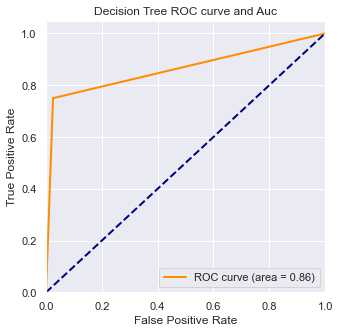

In [74]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt = dt.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_dt,tpr_dt,threshold_dt = roc_curve(np.ravel(y_test), y_score_dt) ###计算真正率和假正率
roc_auc_dt = auc(fpr_dt,tpr_dt) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt, tpr_dt, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc_dt) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

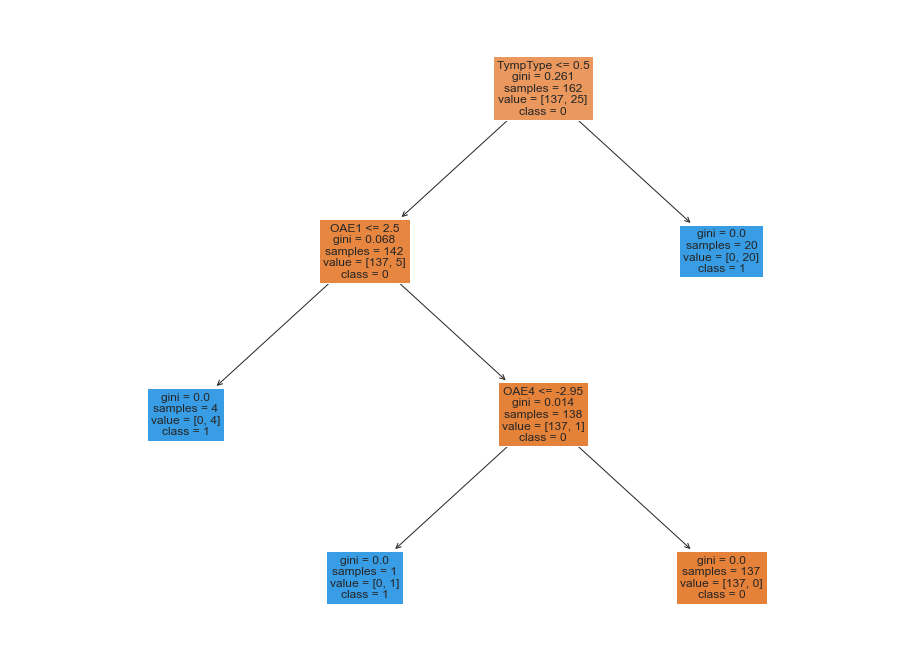

In [75]:
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_dt = plot_tree(dt, feature_names=X_train.columns, fontsize=12, filled=True, class_names=['0', '1'])

### Random Forest

In [76]:
# Random Forest Algorithm
rf = RandomForestClassifier(random_state=42)

In [77]:
rf_auc, rf_rec, rf_model = model_train(rf, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[40  0]
 [ 2  6]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        40
           1       1.00      0.75      0.86         8

    accuracy                           0.96        48
   macro avg       0.98      0.88      0.92        48
weighted avg       0.96      0.96      0.96        48

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 0.875
Random Forest Classifier Recall  Validation Data
Recall 0.75
_________________________


In [78]:
## train set
rf.fit(X_train,y_train)
rf_prediction_train = rf.predict(X_train)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train, rf_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=rf_prediction_train, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=rf_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=rf_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train, rf_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [79]:
## test set
rf.fit(X_train,y_train)
rf_prediction = rf.predict(X_test)
print("Random Forest Conclusion for Original Dataset of validation set")
print('Precision:         ',precision_score(y_test, rf_prediction))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=rf_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=rf_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=rf_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_test, rf_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of validation set
Precision:          1.0
F1-Score:           0.9163763066202091
Accuracy Scores:    0.9583333333333334
Recall Scores:      0.875
Sensitivity:        0.75
Specificity:        1.0


In [81]:
## validation set
rf.fit(X_train,y_train)
rf_prediction = rf.predict(X_val)
print("Random Forest Conclusion for Original Dataset of validation set")
print('Precision:         ',precision_score(y_val, rf_prediction))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=rf_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=rf_prediction))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=rf_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_val, rf_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of validation set
Precision:          1.0
F1-Score:           0.9342403628117915
Accuracy Scores:    0.9655172413793104
Recall Scores:      0.9
Sensitivity:        0.8
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

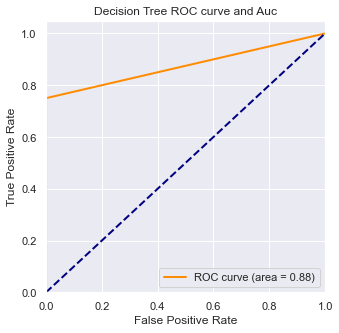

In [82]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf = rf.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_rf,tpr_rf,threshold_rf = roc_curve(np.ravel(y_test), y_score_rf) ###计算真正率和假正率
roc_auc_rf = auc(fpr_rf,tpr_rf) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf, tpr_rf, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc_rf) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Grid Search

In [83]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,15,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs = GridSearchCV(rf, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs.fit(X_train, np.ravel(y_train))
y_pred = rf_gs.predict(X_test)

Fitting 3 folds for each of 1080 candidates, totalling 3240 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s

In [84]:
rf_gs.best_estimator_

RandomForestClassifier(max_depth=5, n_estimators=5, random_state=42)

In [89]:
rf_gs_model=RandomForestClassifier(max_depth=5, n_estimators=5, random_state=42)
rf_gs_model.fit(X_train, y_train)
y_pred_rf_gs = rf_gs_model.predict(X_test)

In [87]:
print("Grid Search Validation Data")
cm_rf_gs = confusion_matrix(y_test, y_pred_rf_gs)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_rf_gs)
print('-----------------------')
cr_rf_gs = classification_report(y_test, y_pred_rf_gs)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_rf_gs)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_rf_gs = roc_auc_score(y_test, y_pred_rf_gs)       
print("AUC Score " + str(auc_rf_gs))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_rf_gs = recall_score(y_test, y_pred_rf_gs)
print("Recall "+ str(rec_rf_gs))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[39  1]
 [ 2  6]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      0.97      0.96        40
           1       0.86      0.75      0.80         8

    accuracy                           0.94        48
   macro avg       0.90      0.86      0.88        48
weighted avg       0.94      0.94      0.94        48

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.8625
Grid Search Recall  Validation Data
Recall 0.75


In [106]:
## train set
rf_gs_model.fit(X_train,y_train)
rf_gs_prediction_train = rf_gs_model.predict(X_train)
print("Random Forest Conclusion for Normal Dataset of train set")
print('Precision:         ',precision_score(y_train, rf_gs_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=rf_gs_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=rf_gs_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=rf_gs_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train, rf_gs_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Normal Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [104]:
## test set
rf_gs_model.fit(X_train,y_train)
rf_gs_prediction_test = rf_gs_model.predict(X_test)
print("Random Forest Conclusion for Normal Dataset of test set")
print('Precision:         ',precision_score(y_test, rf_gs_prediction_test))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=rf_gs_prediction_test, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=rf_gs_prediction_test))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=rf_gs_prediction_test,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test, rf_gs_prediction_test).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of test set
Precision:          0.8571428571428571
F1-Score:           0.8814814814814814
Accuracy Scores:    0.9375
Recall Scores:      0.8625
Sensitivity:        0.75
Specificity:        0.975


In [105]:
rf_gs_model.fit(X_train,y_train)
y_valpred_rf_gs = rf_gs_model.predict(X_val)
print("gs Forest Conclusion for Original Dataset")
print('Precision:         ',precision_score(np.ravel(y_val), y_valpred_rf_gs))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=y_valpred_rf_gs, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=np.ravel(y_val), y_pred=y_valpred_rf_gs))
print('Recall Scores:     ',recall_score(y_true=np.ravel(y_val),y_pred=y_valpred_rf_gs,average='macro'))
tn, fp, fn, tp = confusion_matrix(np.ravel(y_val), y_valpred_rf_gs).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

gs Forest Conclusion for Original Dataset
Precision:          1.0
F1-Score:           0.9342403628117915
Accuracy Scores:    0.9655172413793104
Recall Scores:      0.9
Sensitivity:        0.8
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

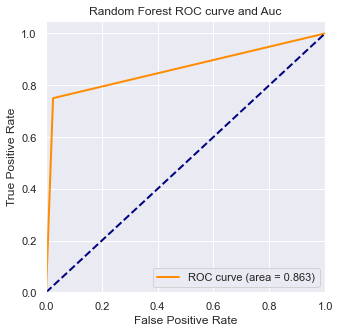

In [107]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs = rf_gs_model.fit(X_train, y_train).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_rf_gs,tpr_rf_gs,threshold_rf_gs = roc_curve(np.ravel(y_test), y_score_rf_gs) ###计算真正率和假正率
roc_auc_rf_gs = auc(fpr_rf_gs,tpr_rf_gs) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs, tpr_rf_gs, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [108]:
rf_random = RandomizedSearchCV(rf, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random.fit(X_train, np.ravel(y_train))
y_pred_random = rf_random.predict(X_test)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=9; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=9; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=9; total time=   0.2s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=11; total time=   0.2s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=11; total time=   0.2s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=19; total time=   0.2s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=19; total time=   0.2s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=19; total time

In [109]:
rf_random.best_estimator_

RandomForestClassifier(max_depth=10, min_samples_split=5, n_estimators=5,
                       random_state=42)

In [110]:
rf_random_model=RandomForestClassifier(max_depth=10, min_samples_split=5, n_estimators=5,
                       random_state=42)
rf_random_model.fit(X_train, np.ravel(y_train))
y_pred_random = rf_random_model.predict(X_test)

In [111]:
print("Randomized Grid Search Validation Data")
cm_rf_random = confusion_matrix(y_test, y_pred_random)                               
print("Randomized Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_rf_random)
print('-----------------------')
cr_rf_random = classification_report(y_test, y_pred_random)
print("Randomized Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_rf_random)
print('------------------------')
print("Randomized Grid Search AUC Score " +" Validation Data")
auc_rf_random = roc_auc_score(y_test, y_pred_random)       
print("AUC Score " + str(auc_rf_random))                                       # Displaying the AUC score
print("Randomized Grid Search Recall " +" Validation Data")
rec_rf_random = recall_score(y_test, y_pred_random)
print("Recall "+ str(rec_rf_random))                                           # Displaying the Recall score

Randomized Grid Search Validation Data
Randomized Grid Search Confusion Matrix  Validation Data
[[39  1]
 [ 2  6]]
-----------------------
Randomized Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      0.97      0.96        40
           1       0.86      0.75      0.80         8

    accuracy                           0.94        48
   macro avg       0.90      0.86      0.88        48
weighted avg       0.94      0.94      0.94        48

------------------------
Randomized Grid Search AUC Score  Validation Data
AUC Score 0.8625
Randomized Grid Search Recall  Validation Data
Recall 0.75


In [112]:
## train set
rf_random_model.fit(X_train,y_train)
rf_random_prediction_train = rf_random_model.predict(X_train)
print("Random Forest Conclusion for NORMAL Dataset of train set")
print('Precision:         ',precision_score(y_train, rf_random_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=rf_random_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=rf_random_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=rf_random_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train, rf_random_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           0.9879777365491651
Accuracy Scores:    0.9938271604938271
Recall Scores:      0.98
Sensitivity:        0.96
Specificity:        1.0


In [113]:
## test set
rf_random_model.fit(X_train,y_train)
rf_random_prediction_test = rf_random_model.predict(X_test)
print("Random Forest Conclusion for NORMAL Dataset of test set")
print('Precision:         ',precision_score(y_test, rf_random_prediction_test))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=rf_random_prediction_test, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=rf_random_prediction_test))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=rf_random_prediction_test,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test, rf_random_prediction_test).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for NORMAL Dataset of test set
Precision:          0.8571428571428571
F1-Score:           0.8814814814814814
Accuracy Scores:    0.9375
Recall Scores:      0.8625
Sensitivity:        0.75
Specificity:        0.975


In [114]:
## validation set
rf_random_model.fit(X_train,y_train)
rf_random_prediction_val = rf_random_model.predict(X_val)
print("Random Forest Conclusion for NORMAL Dataset of val set")
print('Precision:         ',precision_score(y_val, rf_random_prediction_val))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=rf_random_prediction_val, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=rf_random_prediction_val))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=rf_random_prediction_val,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val, rf_random_prediction_val).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for NORMAL Dataset of val set
Precision:          1.0
F1-Score:           0.9342403628117915
Accuracy Scores:    0.9655172413793104
Recall Scores:      0.9
Sensitivity:        0.8
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

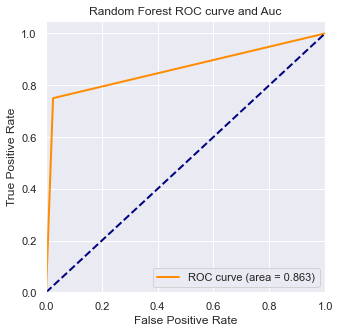

In [115]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random = rf_random_model.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_rf_random,tpr_rf_random,threshold_rf_random = roc_curve(np.ravel(y_test), y_score_rf_random) ###计算真正率和假正率
roc_auc_rf_random = auc(fpr_rf_random,tpr_rf_random) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random, tpr_rf_random, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [116]:
rf_y_train_pred=rf_random.predict(X_train)
print('Accuracy score of train data :{}'.format(rf_random.score(X_train,y_train)))
print('Train data f1_Score:{}'.format(f1_score(y_train, rf_y_train_pred)))

rf_y_val_pred=rf_random.predict(X_val)
print('Accuracy score of validation  data :{}'.format(rf_random.score(X_val,y_val)))
print('validation data f1_Score:{}'.format(f1_score(y_val, rf_y_val_pred)))

Accuracy score of train data :0.9938271604938271
Train data f1_Score:0.9795918367346939
Accuracy score of validation  data :0.9655172413793104
validation data f1_Score:0.888888888888889


Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=14; total time=   0.0s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=14; total time=   0.0s[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=14; total time=   0.0s

[CV] END max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=17; total time=   0.0s
[CV] END max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=17; total time=   0.0s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=13; total time=   0.0s
[CV] END max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=17; total time=   0.0s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=13

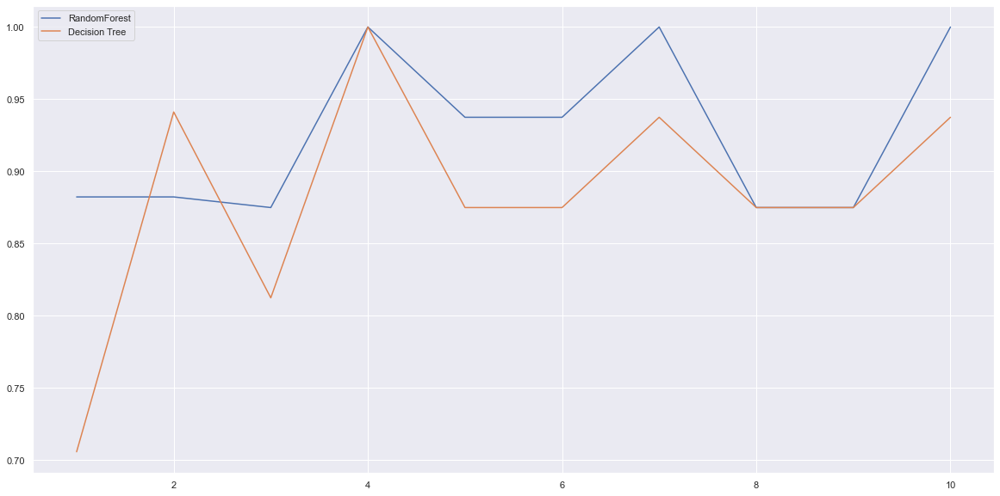

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s=cross_val_score(rf_random,X_train,np.ravel(y_train),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s=cross_val_score(dt,X_train,np.ravel(y_train),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s,label="RandomForest")
plt.plot(range(1,11),clf_s,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=16; total time=   0.0s
[CV] END max_depth=40, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=13; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=17; total time=   0.1s
[CV] END max_depth=40, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=13; total time=   0.1s
[CV] END max_depth=40, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=13; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=17; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=17; total time=   0.1s
[CV] END max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=16; total 

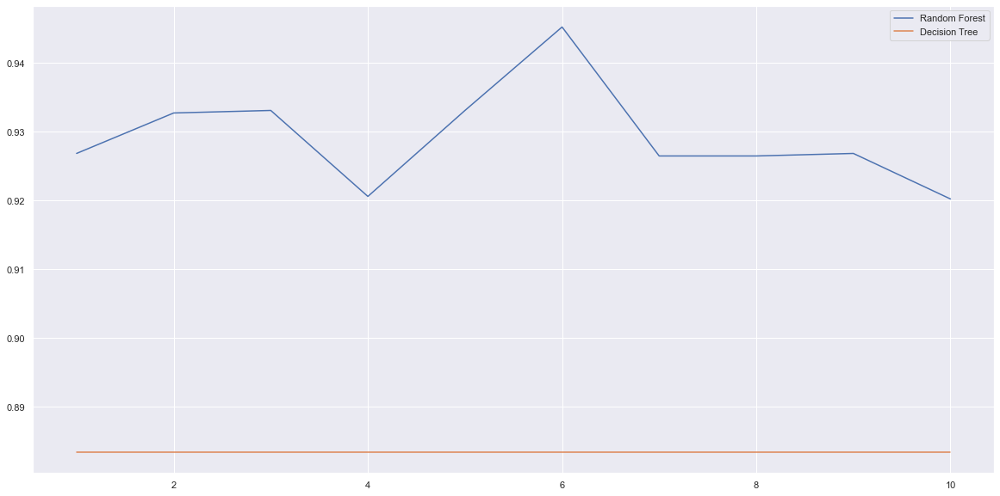

In [ ]:
rfc_l = []
clf_l = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s = cross_val_score(rf_random,X_train,np.ravel(y_train),cv=10).mean()
  rfc_l.append(rfc_s)
  # clf = DecisionTreeClassifier()
  clf_s = cross_val_score(dt,X_train,np.ravel(y_train),cv=10).mean()
  clf_l.append(clf_s)
 
plt.plot(range(1,11),rfc_l,label = "Random Forest")
plt.plot(range(1,11),clf_l,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred=rf_random.predict(X_train)
print('Accuracy score of train data :{}'.format(rf_random.score(X_train,y_train)))
print('Train data f1_Score:{}'.format(f1_score(y_train, rf_y_train_pred)))

rf_y_val_pred=rf_random.predict(X_val)
print('Accuracy score of validation  data :{}'.format(rf_random.score(X_val,y_val)))
print('validation data f1_Score:{}'.format(f1_score(y_val, rf_y_val_pred)))

Accuracy score of train data :0.9629629629629629
Train data f1_Score:0.8749999999999999
Accuracy score of validation  data :0.9655172413793104
validation data f1_Score:0.888888888888889


Random forest accuracy increases from 96% to 98% using cross validation score

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [ ]:
perm = PermutationImportance(dt_model, random_state=101).fit(X_test, y_test)      # Evaluate the permutation importance 
eli5.show_weights(perm, feature_names = X_test.columns.values)                    # Display the weights of each features

Weight,Feature
0.1125 ± 0.1074,f(458.5020)
0.0667 ± 0.0408,f(226.0000)
0.0625 ± 0.0589,f(1090.5077)
0.0417 ± 0.0527,f(577.6763)
0.0417 ± 0.0000,f(1155.3527)
0.0250 ± 0.0167,f(5993.2283)
0 ± 0.0000,f(2593.6791)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(2310.7054)
0 ± 0.0000,f(7127.1897)


Lets check the same with Random Forest classifier

In [ ]:
perm = PermutationImportance(rf_model, random_state=101).fit(X_test, y_test)
eli5.show_weights(perm, feature_names = X_test.columns.values)

Weight,Feature
0.0042 ± 0.0167,f(1296.8396)
0 ± 0.0000,f(1090.5077)
0 ± 0.0000,f(458.5020)
0 ± 0.0000,f(2593.6791)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(2310.7054)
0 ± 0.0000,f(7127.1897)
0 ± 0.0000,f(865.5366)
0 ± 0.0000,f(6727.1713)
0 ± 0.0000,f(226.0000)


Conclusion: The columns in the green are the most important features.

### Shap


#### Lets see how the columns impact a single record of data

In [ ]:
row_to_show = 2                               # The row for which we want to check the SHAP explanations
data_to_predict = X_test.iloc[row_to_show]    # data_to_predict

In [ ]:
data_to_preddict_array = data_to_predict.values.reshape(1,-1)

rf_random_model.predict_proba(data_to_preddict_array) # Prediction probability on the row of the data


array([[1., 0.]])

In [ ]:
rf_random_model.predict(data_to_preddict_array)                                       # Predicted output

array([0])

In [ ]:
y_test.iloc[row_to_show]

OverallPoF    0
Name: 2, dtype: int64

In [ ]:
# Object that can calculate Shap values
explainer_single = shap.TreeExplainer(rf_random_model)                                       # SHAP Tree Explainer

# Calculate the shap values
shap_values_single = explainer_single.shap_values(data_to_predict)                           # SHAP explanations

In [ ]:
shap_values_single[0]

array([ 0.00321393,  0.00674852,  0.00469896,  0.00391443, -0.00149658,
        0.01096948, -0.00641033,  0.0037939 ,  0.00143828,  0.00144365,
        0.02297814,  0.00364237,  0.00681636, -0.0013366 ,  0.01206085,
        0.00172968,  0.0205998 ,  0.00145777,  0.02650045,  0.01921225])

In [ ]:
shap.initjs()
shap.force_plot(explainer_single.expected_value[1], shap_values_single[1], data_to_predict)

红色特征使预测值更大（类似正相关），蓝色使预测值变小，而颜色区域宽度越大，说明该特征的影响越大。（此处图中数字是特征的具体数值） 其中base_value是所有样本的平均预测值，output_value即f(x)是本实例的预测值。本例分析了回归问题，对于分类问题，可以看到base_value和output_value并不在0-1之间，这是由于对数转换造成的。

#### Each feature affects the results

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 7.15 µs


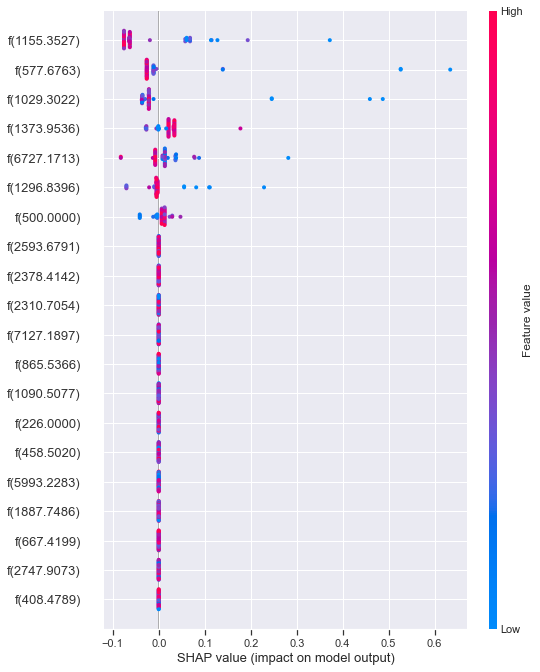

In [ ]:
%time
# samples = X_train
samples = X_test

explainer = shap.TreeExplainer(rf_random.best_estimator_[1])
shap_values = explainer.shap_values(samples, approximate=False, check_additivity=False)

shap.summary_plot(shap_values[1], samples)

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

In [155]:
def make_shap_waterfall_plot(shap_values, features, num_display=20):
    
    '''
    A function for building a SHAP waterfall plot.
    
    SHAP waterfall plot is used to visualize the most important features in a descending order.
    
    Parameters:
    shap_values (list): SHAP values obtained from a model
    features (pandas DataFrame): a list of features used in a model
    num_display(int): number of features to display
    
    Returns:
    matplotlib.pyplot plot: SHAP waterfall plot
    
    '''
    
    column_list = features.columns
    feature_ratio = (np.abs(shap_values).sum(0) / np.abs(shap_values).sum()) * 100
    column_list = column_list[np.argsort(feature_ratio)[::-1]]
    feature_ratio_order = np.sort(feature_ratio)[::-1]
    cum_sum = np.cumsum(feature_ratio_order)
    column_list = column_list[:num_display]
    feature_ratio_order = feature_ratio_order[:num_display]
    cum_sum = cum_sum[:num_display]
    
    num_height = 0
    if (num_display >= 20) & (len(column_list) >= 20):
        num_height = (len(column_list) - 20) * 0.4
        
    fig, ax1 = plt.subplots(figsize=(8, 8 + num_height))
    ax1.plot(cum_sum[::-1], column_list[::-1], c='blue', marker='o')
    ax2 = ax1.twiny()
    ax2.barh(column_list[::-1], feature_ratio_order[::-1], alpha=0.6)
    
    ax1.grid(True)
    ax2.grid(False)
    ax1.set_xticks(np.arange(0, round(cum_sum.max(), -1)+1, 10))
    ax2.set_xticks(np.arange(0, round(feature_ratio_order.max(), -1)+1, 10))
    ax1.set_xlabel('Cumulative Ratio')
    ax2.set_xlabel('Composition Ratio')
    ax1.tick_params(axis="y", labelsize=13)
    plt.ylim(-1, len(column_list))

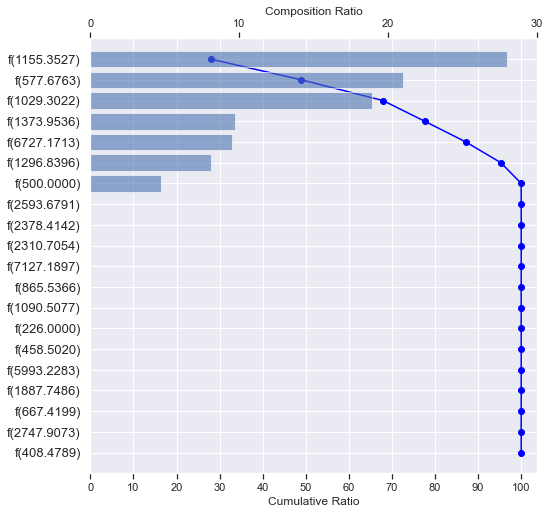

In [ ]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values[1], samples)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 60% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。

In [ ]:
shap.force_plot(explainer.expected_value[1], shap_values[1], samples)


### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                         feature_names=X_train.columns.values.tolist(),
                                                         mode='classification',class_names='Attack')

In [ ]:
lime_expln1=explainer.explain_instance(X_test.iloc[1],dt_model.predict_proba,num_features=X_test.shape[1], top_labels = 1)
lime_expln1.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

In [169]:
# Create a function to generating the prediction results on both the training and test sets
def pred_plot(y_true,y_pred):
    plt.plot(t, y_true, 'r-', linewidth=2, label='true') #t is the abscissa scale
    plt.plot(t, y_pred, 'g-', linewidth=2, label='pred')
    plt.legend(loc = 'lower right')
    plt.grid(visible=True)

The Prediction Results on Testing Set:


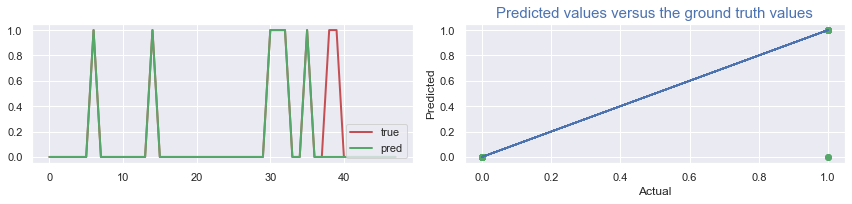

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test))
pred_plot(np.ravel(y_test), np.ravel(y_pred_random)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test), np.ravel(y_test))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test), np.ravel(y_pred_random),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - Oversampling dataset

### Decision Tree

In [123]:
dt_over_large = DecisionTreeClassifier(random_state=42)

The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

In [124]:
dt_over_large.fit(X_train_over_large, y_train_over_large)

DecisionTreeClassifier(random_state=42)

In [130]:
## train set
dt_over_large.fit(X_train_over_large,y_train_over_large)
dt_over_large_prediction_train = dt_over_large.predict(X_train_over_large)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train_over_large, dt_over_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_over_large, y_pred=dt_over_large_prediction_train, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_over_large, y_pred=dt_over_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_over_large,y_pred=dt_over_large_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train_over_large, dt_over_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [131]:
## test set
y_pred_dt_over_large = dt_over_large.predict(X_test_over_large)
print("Decision Tree Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_dt_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [137]:
## validation set
y_valpred_dt_over_large = dt_over_large.predict(X_val_over_large)
print("Decision Tree Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Original Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

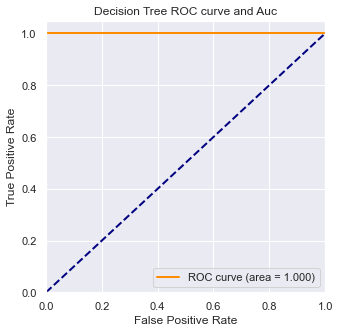

In [139]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_over_large = dt_over_large.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_dt_over_large,tpr_dt_over_large,threshold_dt_over_large = roc_curve(np.ravel(y_test_over_large), y_score_dt_over_large) ###计算真正率和假正率
roc_auc_dt_over_large = auc(fpr_dt_over_large,tpr_dt_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_over_large, tpr_dt_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

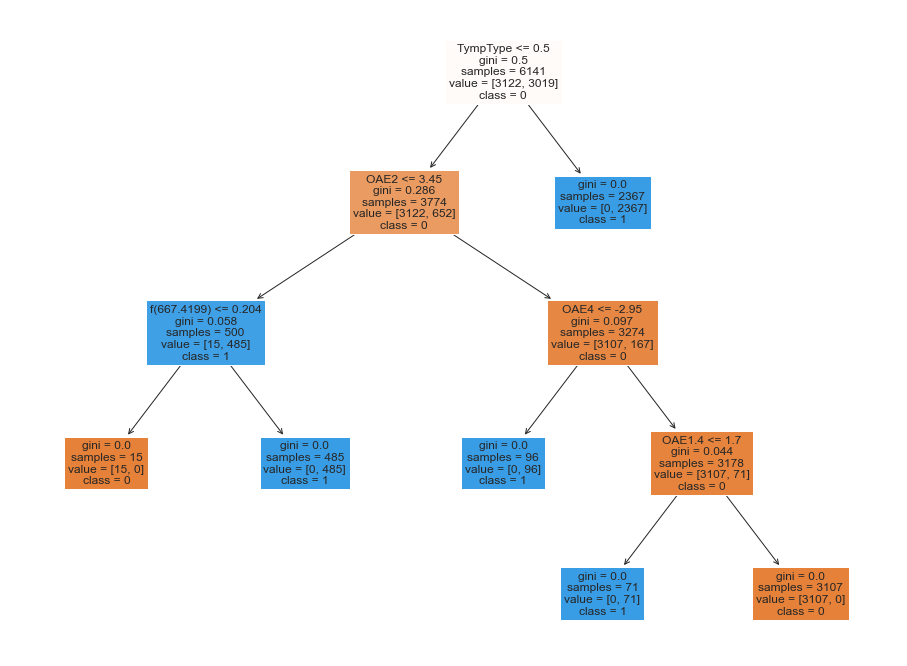

In [140]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_over_large.fit(X_train_over_large,y_train_over_large)
predictions_dt_over_large = dt_over_large.predict(X_test_over_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_over = plot_tree(dt_over_large, feature_names=X_train_over_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

### Random Forest

In [141]:
rf_over_large = RandomForestClassifier(random_state = 42)

In [142]:
## train set
rf_over_large.fit(X_train_over_large,y_train_over_large)
rf_over_prediction_train = rf_over_large.predict(X_train_over_large)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train_over_large, rf_over_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_over_large, y_pred=rf_over_prediction_train, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_over_large, y_pred=rf_over_prediction_train))
tn, fp, fn, tp = confusion_matrix(y_train_over_large, rf_over_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Sensitivity:        1.0
Specificity:        1.0


In [144]:
## test set
y_pred_rf_over_large = rf_over_large.predict(X_test_over_large)
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_rf_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_rf_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_rf_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_rf_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_rf_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [145]:
## validation set
y_valpred_dt_over_large = dt_over_large.predict(X_val_over_large)
print("Random Forest Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

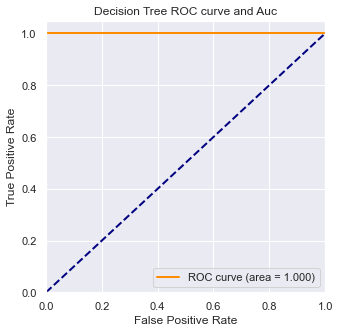

In [146]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_over_large = rf_over_large.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_rf_over_large,tpr_rf_over_large,threshold_rf_over_large = roc_curve(np.ravel(y_test_over_large), y_score_rf_over_large) ###计算真正率和假正率
roc_auc_rf_over_large = auc(fpr_rf_over_large,tpr_rf_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_over_large, tpr_rf_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [147]:
rf_y_train_pred_over_large = rf_over_large.predict(X_train_over_large)
print('Accuracy score of train data :{}'.format(rf_over_large.score(X_train_over_large,y_train_over_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_over_large, rf_y_train_pred_over_large)))

rf_y_val_pred_over_large = rf_over_large.predict(X_val_over_large)
print('Accuracy score of validation  data :{}'.format(rf_over_large.score(X_val_over_large,y_val_over_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_over_large, rf_y_val_pred_over_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :1.0
validation data f1_Score:1.0


### Grid Search

In [148]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_over_large = GridSearchCV(rf, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_over_large.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_over_large = rf_gs_over_large.predict(X_test_over_large)

Fitting 3 folds for each of 810 candidates, totalling 2430 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.4s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.4s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.5s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.5s


In [149]:
rf_gs_over_large.best_estimator_

RandomForestClassifier(max_depth=5, n_estimators=5, random_state=42)

In [150]:
rf_gs_over_large_model=RandomForestClassifier(max_depth=5, n_estimators=5, random_state=42)
rf_gs_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_gs_over_large = rf_gs_over_large_model.predict(X_test_over_large)

In [151]:
print("Grid Search Validation Data")
cm_over_large = confusion_matrix(y_test_over_large, y_pred_gs_over_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_over_large)
print('-----------------------')
cr_over_large = classification_report(y_test_over_large, y_pred_gs_over_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_over_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_over_large = roc_auc_score(y_test_over_large, y_pred_gs_over_large)       
print("AUC Score " + str(auc_over_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_over_large = recall_score(y_test_over_large, y_pred_gs_over_large)
print("Recall "+ str(rec_over_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Grid Search AUC Score  Validation Data
AUC Score 1.0
Grid Search Recall  Validation Data
Recall 1.0


In [152]:
## test set
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_gs_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_gs_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_gs_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_gs_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_gs_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [153]:
## validation set
y_valpred_gs_over_large = rf_gs_over_large_model.predict(X_val_over_large)
print("Random Forest Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_gs_over_large))
# print(f1_score(y_true=y_val, y_valpred=y_valpred_gs_over_large, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_gs_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_gs_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_gs_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)


Random Forest Conclusion for Original Dataset of val set
Precision:          1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

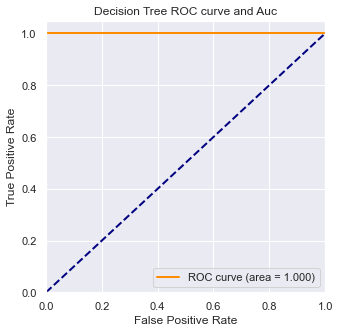

In [154]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_over_large = rf_gs_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_over_large,tpr_rf_gs_over_large,threshold_rf_gs_over_large = roc_curve(np.ravel(y_test_over_large), y_score_rf_gs_over_large) ###计算真正率和假正率
roc_auc_rf_gs_over_large = auc(fpr_rf_gs_over_large,tpr_rf_gs_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_over_large, tpr_rf_gs_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

超参数优化也就是常说的调参，python-sklearn里常用的有GridSearchCV和RandomizedSearchCV可以用。其中GridSearchCV的原理很简明，就是程序去挨个尝试每一组超参数，然后选取最好的那一组。可以想象，这个是比较费时间的，面临着维度灾难。因此James Bergstra和Yoshua Bengio在2012年提出了超参数优化的RandomSearch方法。

（2）RandomizedSearchCV是在论文的基础上加入了cross-validation

In [155]:
rf_random_over_large = RandomizedSearchCV(rf_over_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random_over_large.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_over_large = rf_random_over_large.predict(X_test_over_large)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=9; total time=   0.1s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=7; total time=   0.0s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=9; total time=   0.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=9; total time=   0.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=9; total time=   0.1s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, n_estimators=9; total time=   0.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=9; total time=   0.1s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=7; total time=

In [156]:
rf_random_over_large.best_estimator_

RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_split=5,
                       n_estimators=9, random_state=42)

In [158]:
rf_random_over_large_model = RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_split=5,
                       n_estimators=9, random_state=42)
rf_random_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_random_over_large = rf_random_over_large_model.predict(X_test_over_large)

In [159]:
print("Grid Search Validation Data")
cm_over_large = confusion_matrix(y_test_over_large, y_pred_gs_over_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_over_large)
print('-----------------------')
cr_over_large = classification_report(y_test_over_large, y_pred_gs_over_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_over_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_over_large = roc_auc_score(y_test_over_large, y_pred_gs_over_large)       
print("AUC Score " + str(auc_over_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_over_large = recall_score(y_test_over_large, y_pred_gs_over_large)
print("Recall "+ str(rec_over_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Grid Search AUC Score  Validation Data
AUC Score 1.0
Grid Search Recall  Validation Data
Recall 1.0


In [162]:
## test set
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_random_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_random_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_random_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_random_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_random_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [160]:
## validation set
y_valpred_random_over_large = rf_random_over_large_model.predict(X_val_over_large)
print("Random Forest Conclusion for Over Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_random_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_random_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_random_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_random_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_random_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)


Random Forest Conclusion for Over Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

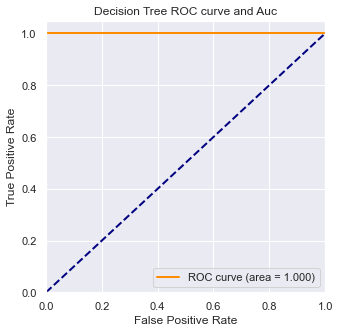

In [163]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_over_large = rf_gs_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_over_large,tpr_rf_gs_over_large,threshold_rf_gs_over_large = roc_curve(np.ravel(y_test_over_large), y_score_rf_gs_over_large) ###计算真正率和假正率
roc_auc_rf_gs_over_large = auc(fpr_rf_gs_over_large,tpr_rf_gs_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_over_large, tpr_rf_gs_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [ ]:
perm_over_large = PermutationImportance(rf_random_over_large_model, random_state=101).fit(X_test_over_large, y_test_over_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_over_large, feature_names = X_test_over_large.columns.values) # Display the weights of each features

Lets check the same with Random Forest classifier

In [ ]:
perm_over_large = PermutationImportance(rf_random_over_large_model, random_state=101).fit(X_test_over_large, y_test_over_large)
eli5.show_weights(perm_over_large, feature_names = X_test_over_large.columns.values)

Weight,Feature
0.0056 ± 0.0018,f(1296.8396)
0.0035 ± 0.0039,f(1029.3022)
0 ± 0.0000,f(1090.5077)
0 ± 0.0000,f(458.5020)
0 ± 0.0000,f(2593.6791)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(2310.7054)
0 ± 0.0000,f(7127.1897)
0 ± 0.0000,f(865.5366)
0 ± 0.0000,f(6727.1713)


Conclusion: The columns in the green are the most important features.

### Shap

#### Lets see how the columns impact a single record of data

In [ ]:
row_to_show = 27                                      # The row for which we want to check the SHAP explanations
data_to_predict_over_large = X_test_over_large.iloc[row_to_show] # data_to_predict

In [ ]:
data_to_preddict_array_over_large = data_to_predict_over_large.values.reshape(1,-1)

dt_model_over_large.predict_proba(data_to_preddict_array_over_large)  # Prediction probability on the row of the data


array([[0., 1.]])

In [ ]:
dt_model_over_large.predict(data_to_preddict_array_over_large)                                       # Predicted output

array([1])

In [ ]:
y_test_over_large.iloc[row_to_show]

OverallPoF    1
Name: 27, dtype: int64

In [ ]:
# Object that can calculate Shap values
explainer_over_large = shap.TreeExplainer(dt_model_over_large)                       # SHAP Tree Explainer

# Calculate the shap values
shap_values_over_large = explainer_over_large.shap_values(data_to_predict_over_large) # SHAP explanations

In [ ]:
shap.initjs()
shap.force_plot(explainer_over_large.expected_value[1], shap_values_over_large[1], data_to_predict_over_large)

#### Each feature affects the results

In [ ]:
%time
# samples = X_train_over_large
samples_over_large = X_test_over_large

explainer_over_large = shap.TreeExplainer(rf_gs_over_large_model.best_estimator_[1])
shap_values_over_large = explainer_over_large.shap_values(samples_over_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_over_large[1], samples_over_large)

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 5.96 µs


AttributeError: 'RandomForestClassifier' object has no attribute 'best_estimator_'

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

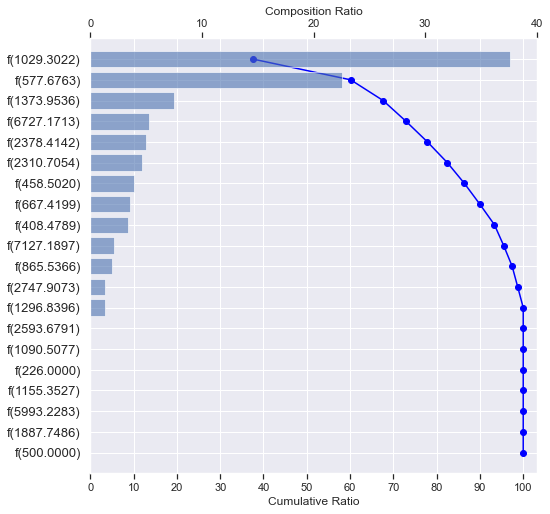

In [ ]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_over_large[1], samples_over_large)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 6540% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。Feature contribution

In [ ]:
shap.force_plot(explainer_over_large.expected_value[1], shap_values_over_large[1], samples_over_large)

### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer_over = lime.lime_tabular.LimeTabularExplainer(X_train_over.values,
                                                         feature_names=X_train_over.columns.values.tolist(),
                                                         mode='classification',class_names='Attack')

In [ ]:
lime_expln1_over=explainer_over.explain_instance(X_test_over.iloc[1],dt_model_over.predict_proba,num_features=X_test_over.shape[1], top_labels = 1)
lime_expln1_over.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


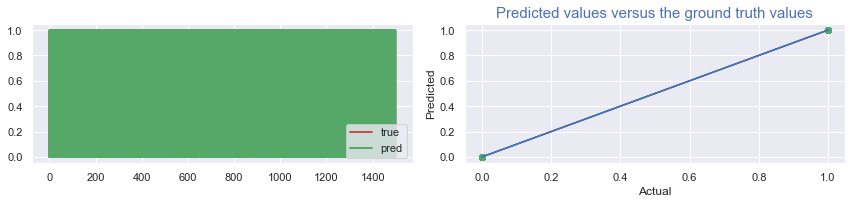

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_over_large))
pred_plot(np.ravel(y_test_over_large), np.ravel(y_pred_over_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_over_large), np.ravel(y_test_over_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_over_large), np.ravel(y_pred_over_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - SMOTE dataset

### Training Model Function

In [47]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, recall_score
def model_smote_large_train(model_smote_large, name):
    model_smote_large.fit(X_train_smote_large, y_train_smote_large)     # Fitting the model_smote_large
    y_pred_smote_large = model_smote_large.predict(X_test_smote_large)  # Making prediction from the trained model_smote_large
    cm_smote_large = confusion_matrix(y_test_smote_large, y_pred_smote_large)                               
    print("Grid Search Confusion Matrix " +" Validation Data")          # Displaying the Confusion Matrix
    print(cm_smote_large)
    print('-----------------------')
    print('-----------------------')
    cr_smote_large = classification_report(y_test_smote_large, y_pred_smote_large)
    print(name +" Classification Report " +" Validation Data")          # Displaying the Classification Report
    print(cr_smote_large)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc_smote_large = roc_auc_score(y_test_smote_large, y_pred_smote_large)       
    print("AUC Score " + str(auc_smote_large))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec_smote_large = recall_score(y_test_smote_large, y_pred_smote_large)
    print("Recall "+ str(rec_smote_large))                                           # Displaying the Recall score
    return auc_smote_large, rec_smote_large, model_smote_large

### Decision Tree

In [48]:
dt_smote_large = DecisionTreeClassifier(random_state=42)

In [49]:
dt_auc_smote_large, dt_rec_smote_large, dt_model_smote_large = model_smote_large_train(dt_smote_large, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[748   2]
 [  0 750]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.9986666666666666
Decision Tree Recall  Validation Data
Recall 1.0


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

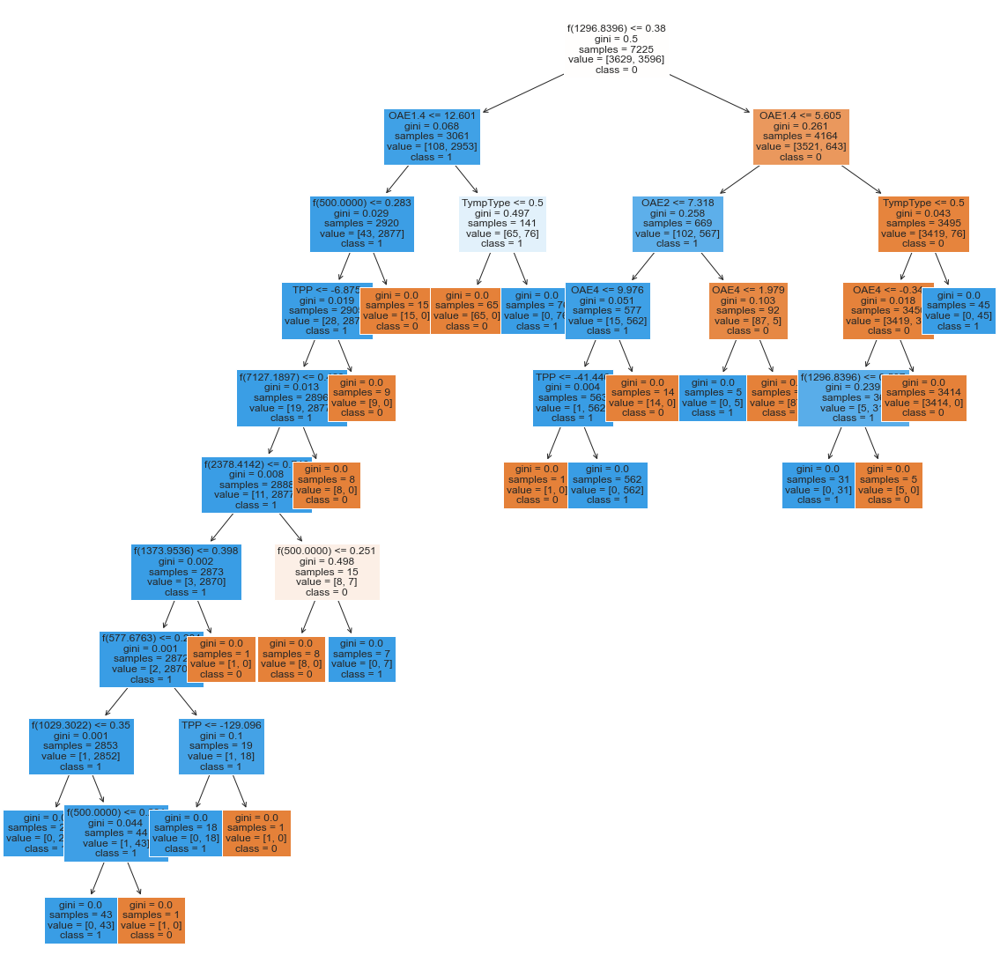

In [50]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_smote_large.fit(X_train_smote_large,y_train_smote_large)
predictions_dt_smote_large = dt_smote_large.predict(X_test_smote_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(20,20))
a_rf_smote_large = plot_tree(dt_smote_large, feature_names=X_train_smote_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [51]:
## train set
dt_smote_large.fit(X_train_smote_large,y_train_smote_large)
dt_smote_large_prediction_train = dt_smote_large.predict(X_train_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, dt_smote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=dt_smote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=dt_smote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=dt_smote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, dt_smote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [52]:
## test set
dt_smote_large.fit(X_train_smote_large,y_train_smote_large)
dt_smote_large_prediction = dt_smote_large.predict(X_test_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, dt_smote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=dt_smote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=dt_smote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=dt_smote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, dt_smote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of test set
Precision:          0.9973404255319149
F1-Score:           0.998666664296292
Accuracy Scores:    0.9986666666666667
Recall Scores:      0.9986666666666666
Sensitivity:        1.0
Specificity:        0.9973333333333333


In [53]:
## validation set
y_valpred_dt_smote_large = dt_smote_large.predict(X_val_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_dt_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_dt_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_dt_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_dt_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_dt_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of val set
Precision:          0.9969465648854962
F1-Score:           0.9976453844302353
Accuracy Scores:    0.9976470588235294
Recall Scores:      0.9976251680479842
Sensitivity:        0.9984709480122325
Specificity:        0.9967793880837359


<Figure size 1440x720 with 0 Axes>

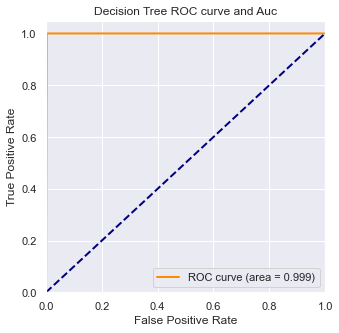

In [54]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_smote_large = dt_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_dt_smote_large,tpr_dt_smote_large,threshold_dt_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_dt_smote_large) ###计算真正率和假正率
roc_auc_dt_smote_large = auc(fpr_dt_smote_large,tpr_dt_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_smote_large, tpr_dt_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Random Forest

In [55]:
rf_smote_large = RandomForestClassifier(random_state=42)

In [56]:
rf_auc_smote_large, rf_rec_smote_large, rf_model_smote_large = model_smote_large_train(rf_smote_large, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 1.0
Random Forest Classifier Recall  Validation Data
Recall 1.0


In [57]:
## train set
rf_smote_large.fit(X_train_smote_large,y_train_smote_large)
rf_smote_large_prediction_train = rf_smote_large.predict(X_train_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, rf_smote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=rf_smote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=rf_smote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=rf_smote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, rf_smote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [58]:
## test set
rf_smote_large.fit(X_train_smote_large,y_train_smote_large)
rf_smote_large_prediction = rf_smote_large.predict(X_test_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, rf_smote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=rf_smote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=rf_smote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=rf_smote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, rf_smote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [59]:
## validation set
y_valpred_smote_large = rf_smote_large.predict(X_val_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

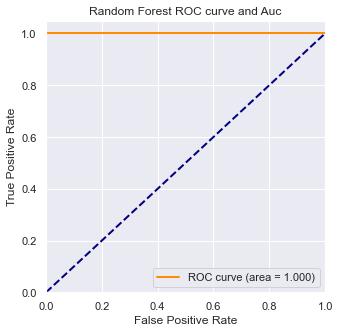

In [60]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_smote_large = rf_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_smote_large,tpr_rf_smote_large,threshold_rf_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_rf_smote_large) ###计算真正率和假正率
roc_auc_rf_smote_large = auc(fpr_rf_smote_large,tpr_rf_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_smote_large, tpr_rf_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [61]:
rf_y_train_pred_smote_large=rf_smote_large.predict(X_train_smote_large)
print('Accuracy score of train data :{}'.format(rf_smote_large.score(X_train_smote_large,y_train_smote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_smote_large, rf_y_train_pred_smote_large)))

rf_y_val_pred_smote_large=rf_smote_large.predict(X_val_smote_large)
print('Accuracy score of validation  data :{}'.format(rf_smote_large.score(X_val_smote_large,y_val_smote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_smote_large, rf_y_val_pred_smote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :1.0
validation data f1_Score:1.0


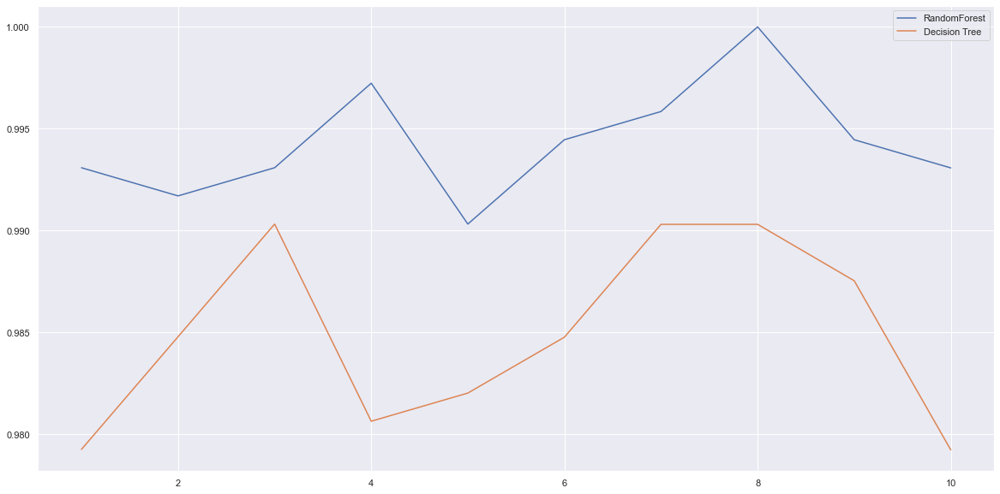

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s_smote_large=cross_val_score(rf_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s_smote_large=cross_val_score(dt_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s_smote_large,label="RandomForest")
plt.plot(range(1,11),clf_s_smote_large,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

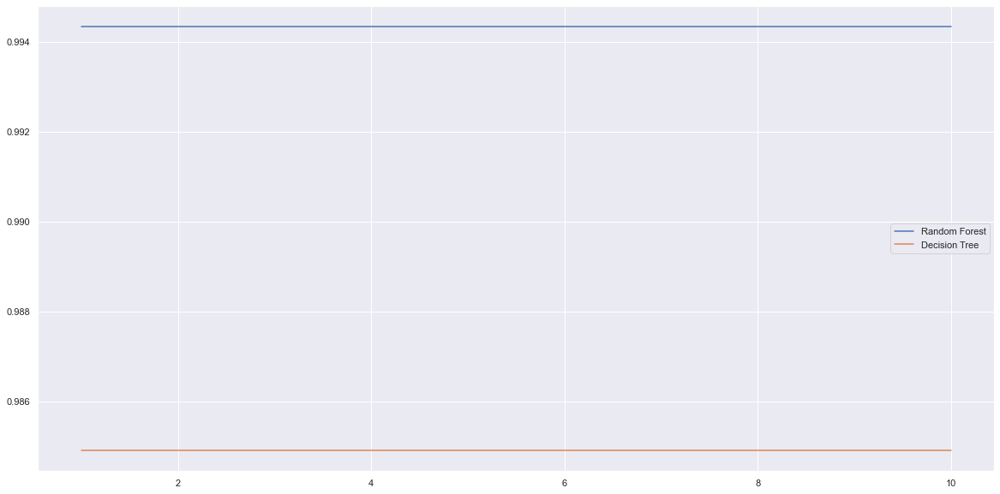

In [ ]:
rfc_l_smote_large = []
clf_l_smote_large = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s_smote_large = cross_val_score(rf_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10).mean()
  rfc_l_smote_large.append(rfc_s_smote_large)
  # clf = DecisionTreeClassifier()
  clf_s_smote_large = cross_val_score(dt_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10).mean()
  clf_l_smote_large.append(clf_s_smote_large)
 
plt.plot(range(1,11),rfc_l_smote_large,label = "Random Forest")
plt.plot(range(1,11),clf_l_smote_large,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred_smote_large=rf_smote_large.predict(X_train_smote_large)
print('Accuracy score of train data :{}'.format(rf_smote_large.score(X_train_smote_large,y_train_smote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_smote_large, rf_y_train_pred_smote_large)))

rf_y_val_pred_smote_large=rf_smote_large.predict(X_val_smote_large)
print('Accuracy score of validation  data :{}'.format(rf_smote_large.score(X_val_smote_large,y_val_smote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_smote_large, rf_y_val_pred_smote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9945098039215686
validation data f1_Score:0.9946360153256705


### Grid Search

In [62]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_smote_large = GridSearchCV(rf_smote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_smote_large = rf_gs_smote_large.predict(X_test_smote_large)

Fitting 3 folds for each of 810 candidates, totalling 2430 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s


In [63]:
rf_gs_smote_large.best_estimator_

RandomForestClassifier(max_depth=10, n_estimators=8, random_state=42)

In [64]:
rf_gs_smote_large_model=RandomForestClassifier(max_depth=10, n_estimators=8, random_state=42)
rf_gs_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_gs_smote_large = rf_gs_smote_large_model.predict(X_test_smote_large)

In [65]:
print("Grid Search Validation Data")
cm_smote_large = confusion_matrix(y_test_smote_large, y_pred_gs_smote_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_smote_large)
print('-----------------------')
cr_smote_large = classification_report(y_test_smote_large, y_pred_gs_smote_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_smote_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_smote_large = roc_auc_score(y_test_smote_large, y_pred_gs_smote_large)       
print("AUC Score " + str(auc_smote_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_smote_large = recall_score(y_test_smote_large, y_pred_gs_smote_large)
print("Recall "+ str(rec_smote_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Grid Search AUC Score  Validation Data
AUC Score 1.0
Grid Search Recall  Validation Data
Recall 1.0


In [66]:
## train set
rf_gs_smote_large_model.fit(X_train_smote_large,y_train_smote_large)
y_pred_gs_smote_large_train = rf_gs_smote_large_model.predict(X_train_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, y_pred_gs_smote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=y_pred_gs_smote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=y_pred_gs_smote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=y_pred_gs_smote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, y_pred_gs_smote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [67]:
## test set
y_pred_gs_smote_large = rf_gs_smote_large_model.predict(X_test_smote_large)
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, y_pred_gs_smote_large))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=y_pred_gs_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=y_pred_gs_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=y_pred_gs_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, y_pred_gs_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [68]:
## validation set
y_valpred_gs_smote_large = rf_gs_smote_large_model.predict(X_val_smote_large)
print("Random Forest Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_gs_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_gs_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_gs_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

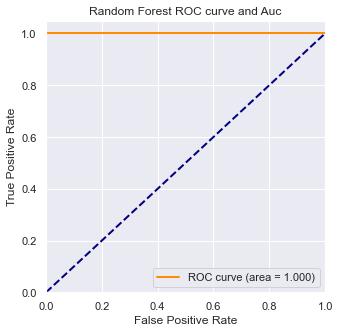

In [69]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_smote_large = rf_gs_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_smote_large,tpr_rf_gs_smote_large,threshold_rf_gs_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_rf_gs_smote_large) ###计算真正率和假正率
roc_auc_rf_gs_smote_large = auc(fpr_rf_gs_smote_large,tpr_rf_gs_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_smote_large, tpr_rf_gs_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [70]:
rf_random_smote_large = RandomizedSearchCV(rf_smote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_smote_large = rf_random_smote_large.predict(X_test_smote_large)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=7; total time=   0.3s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=7; total time=   0.3s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=7; total time=   0.3s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=15; total time=   0.4s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=15; total time=   0.4

In [71]:
rf_random_smote_large.best_estimator_

RandomForestClassifier(max_depth=20, max_features='sqrt', n_estimators=18,
                       random_state=42)

In [72]:
rf_random_smote_large_model = RandomForestClassifier(max_depth=20, max_features='sqrt', n_estimators=18,
                       random_state=42)
rf_random_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_random_smote_large = rf_random_smote_large_model.predict(X_test_smote_large)

In [73]:
print("Randomized Grid Search Validation Data")
cm_smote_large = confusion_matrix(y_test_smote_large, y_pred_random_smote_large)                               
print("Randomized Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_smote_large)
print('-----------------------')
cr_smote_large = classification_report(y_test_smote_large, y_pred_random_smote_large)
print("Randomized Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_smote_large)
print('------------------------')
print("Randomized Grid Search AUC Score " +" Validation Data")
auc_smote_large = roc_auc_score(y_test_smote_large, y_pred_random_smote_large)       
print("AUC Score " + str(auc_smote_large))                                       # Displaying the AUC score
print("Randomized Grid Search Recall " +" Validation Data")
rec_smote_large = recall_score(y_test_smote_large, y_pred_random_smote_large)
print("Recall "+ str(rec_smote_large))                                           # Displaying the Recall score

Randomized Grid Search Validation Data
Randomized Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
Randomized Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Randomized Grid Search AUC Score  Validation Data
AUC Score 1.0
Randomized Grid Search Recall  Validation Data
Recall 1.0


In [74]:
## train set
rf_random_smote_large_model.fit(X_train_smote_large,y_train_smote_large)
y_pred_random_smote_large_train = rf_random_smote_large_model.predict(X_train_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, y_pred_random_smote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=y_pred_random_smote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=y_pred_random_smote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=y_pred_random_smote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, y_pred_random_smote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [75]:
## test set
y_pred_random_smote_large = rf_random_smote_large_model.predict(X_test_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, y_pred_random_smote_large))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=y_pred_random_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=y_pred_random_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=y_pred_random_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, y_pred_random_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [76]:
## validation set
y_valpred_random_smote_large = rf_random_smote_large_model.predict(X_val_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_random_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_random_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_random_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_random_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_random_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

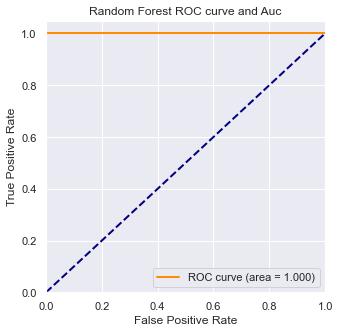

In [77]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random_smote_large = rf_random_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_random_smote_large,tpr_rf_random_smote_large,threshold_rf_random_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_rf_random_smote_large) ###计算真正率和假正率
roc_auc_rf_random_smote_large = auc(fpr_rf_random_smote_large,tpr_rf_random_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random_smote_large, tpr_rf_random_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [171]:
perm_smote_large = PermutationImportance(rf_gs_smote_large, random_state=42).fit(X_test_smote_large, y_test_smote_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_smote_large, feature_names = X_test_smote_large.columns.values)# Display the weights of each features

Weight,Feature
0.0596 ± 0.0043,OAE1.4
0.0548 ± 0.0069,OAE2
0.0323 ± 0.0063,TPP
0.0136 ± 0.0038,f(1296.8396)
0.0120 ± 0.0015,OAE4
0.0019 ± 0.0027,OAE2.8
0.0011 ± 0.0018,OAE1
0.0008 ± 0.0005,TympType
0.0008 ± 0.0005,f(458.5020)
0.0004 ± 0.0007,f(1373.9536)


Lets check the same with Random Forest classifier

In [172]:
perm_smote_large = PermutationImportance(rf_gs_smote_large, random_state=101).fit(X_test_smote_large, y_test_smote_large)
eli5.show_weights(perm_smote_large, feature_names = X_test_smote_large.columns.values)

Weight,Feature
0.0617 ± 0.0022,OAE1.4
0.0540 ± 0.0022,OAE2
0.0289 ± 0.0085,TPP
0.0165 ± 0.0040,f(1296.8396)
0.0127 ± 0.0030,OAE4
0.0020 ± 0.0012,OAE2.8
0.0011 ± 0.0011,TympType
0.0008 ± 0.0005,OAE1
0.0007 ± 0.0000,f(458.5020)
0.0001 ± 0.0005,f(1373.9536)


Conclusion: The columns in the green are the most important features.

### Shap
Lets see how the columns impact a single record of data

In [173]:
row_to_show = 20                                                                # The row for which we want to check the SHAP explanations
data_to_predict_smote_large = X_test_smote_large.iloc[row_to_show]
#data_to_predict

In [174]:
data_to_preddict_array_smote_large = data_to_predict_smote_large.values.reshape(1,-1)

dt_model_smote_large.predict_proba(data_to_preddict_array_smote_large) # Prediction probability on the row of the data


array([[1., 0.]])

In [175]:
dt_model_smote_large.predict(data_to_preddict_array_smote_large)       # Predicted output

array([0])

In [176]:
y_test_smote_large.iloc[row_to_show]

OverallPoF    0
Name: 20, dtype: int64

In [177]:
# Object that can calculate Shap values
explainer_smote_large = shap.TreeExplainer(dt_model_smote_large)                         # SHAP Tree Explainer

# Calculate the shap values
shap_values_smote_large = explainer_smote_large.shap_values(data_to_predict_smote_large) # SHAP explanations

In [178]:
shap.initjs()
shap.force_plot(explainer_smote_large.expected_value[1], shap_values_smote_large[1], data_to_predict_smote_large)

#### Each feature affects the results

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 14.1 µs


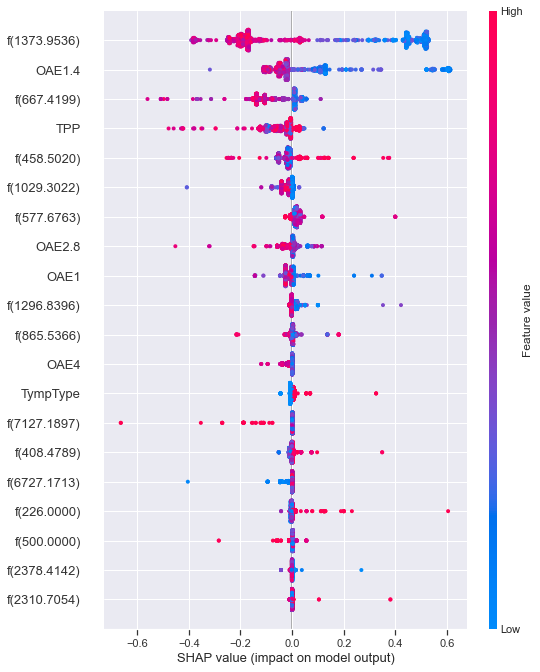

In [181]:
%time
# samples = X_train
samples_smote_large = X_test_smote_large

explainer_smote_large = shap.TreeExplainer(rf_random_smote_large.best_estimator_[1])
shap_values_smote_large = explainer_smote_large.shap_values(samples_smote_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_smote_large[1], samples_smote_large)

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

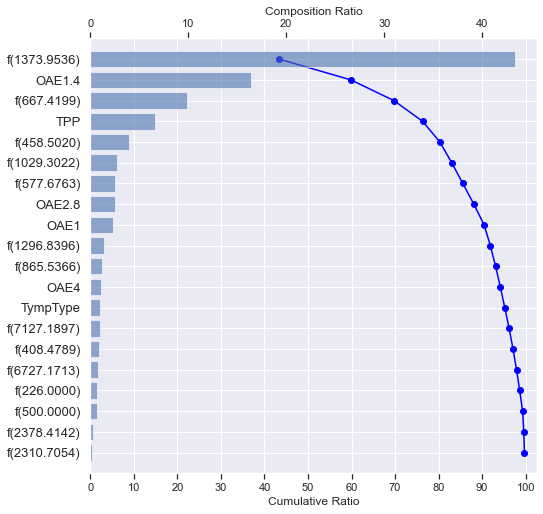

In [182]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_smote_large[1], samples_smote_large)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 50% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。

In [183]:
shap.force_plot(explainer_smote_large.expected_value[1], shap_values_smote_large[1], samples_smote_large)

### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer_smote = lime.lime_tabular.LimeTabularExplainer(X_train_smote.values,
                                                         feature_names=X_train_smote.columns.values.tolist(),
                                                         mode='classification',class_names='Attack')

In [ ]:
lime_expln1_smote=explainer_smote.explain_instance(X_test_smote.iloc[1],dt_model_smote.predict_proba,num_features=X_test_smote.shape[1], top_labels = 1)
lime_expln1_smote.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


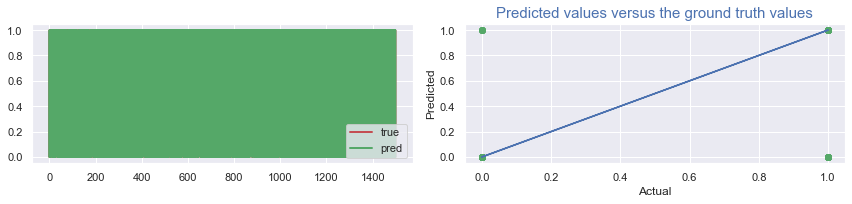

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_smote_large))
pred_plot(np.ravel(y_test_smote_large), np.ravel(y_pred_gs_smote_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_smote_large), np.ravel(y_test_smote_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_smote_large), np.ravel(y_pred_gs_smote_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - SVM SMOTE dataset

### Training Model Function

In [114]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, recall_score
def model_svmsmote_large_train(model_svmsmote_large, name):
    model_svmsmote_large.fit(X_train_svmsmote_large, y_train_svmsmote_large)                                          # Fitting the model_svmsmote_large
    y_pred_svmsmote_large = model_svmsmote_large.predict(X_test_svmsmote_large)                                       # Making prediction from the trained model_svmsmote_large
    cm_svmsmote_large = confusion_matrix(y_test_svmsmote_large, y_pred_svmsmote_large)                               
    print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
    print(cm_svmsmote_large)
    print('-----------------------')
    print('-----------------------')
    cr_svmsmote_large = classification_report(y_test_svmsmote_large, y_pred_svmsmote_large)
    print(name +" Classification Report " +" Validation Data")           # Displaying the Classification Report
    print(cr_svmsmote_large)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc_svmsmote_large = roc_auc_score(y_test_svmsmote_large, y_pred_svmsmote_large)       
    print("AUC Score " + str(auc_svmsmote_large))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec_svmsmote_large = recall_score(y_test_svmsmote_large, y_pred_svmsmote_large)
    print("Recall "+ str(rec_svmsmote_large))                                           # Displaying the Recall score
    return auc_svmsmote_large, rec_svmsmote_large, model_svmsmote_large

### Decision Tree

In [115]:
dt_svmsmote_large = DecisionTreeClassifier(random_state=42)

In [116]:
dt_auc_svmsmote_large, dt_rec_svmsmote_large, dt_model_svmsmote_large = model_svmsmote_large_train(dt_svmsmote_large, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[692   0]
 [  1 749]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       692
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.9993333333333334
Decision Tree Recall  Validation Data
Recall 0.9986666666666667


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

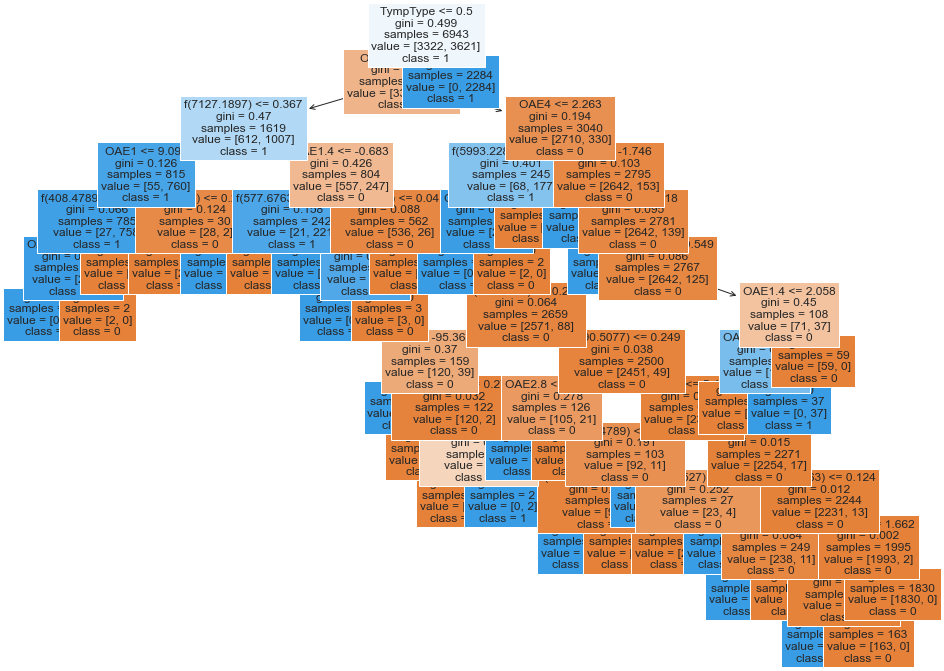

In [117]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
predictions_dt_svmsmote_large = dt_svmsmote_large.predict(X_test_svmsmote_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_svmsmote_large = plot_tree(dt_svmsmote_large, feature_names=X_train_svmsmote_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [118]:
## train set
dt_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
dt_svmsmote_large_prediction_train = dt_svmsmote_large.predict(X_train_svmsmote_large)
print("Decision Tree Conclusion for SVM SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, dt_svmsmote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=dt_svmsmote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=dt_svmsmote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=dt_svmsmote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, dt_svmsmote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SVM SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [119]:
## test set
dt_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
dt_svmsmote_large_prediction = dt_svmsmote_large.predict(X_test_svmsmote_large)
print("Decision Tree Conclusion for SVM SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, dt_svmsmote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=dt_svmsmote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=dt_svmsmote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=dt_svmsmote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, dt_svmsmote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SVM SMOTE Dataset of test set
Precision:          1.0
F1-Score:           0.9993054334658724
Accuracy Scores:    0.9993065187239945
Recall Scores:      0.9993333333333334
Sensitivity:        0.9986666666666667
Specificity:        1.0


In [120]:
## validation set
y_valpred_dt_svmsmote_large = dt_svmsmote_large.predict(X_val_svmsmote_large)
print("Decision Tree Conclusion for SVM svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_dt_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_dt_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_dt_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_dt_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_dt_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SVM svmsmote Dataset of val set
Precision:          0.9984076433121019
F1-Score:           0.9975514524520426
Accuracy Scores:    0.9975530179445351
Recall Scores:      0.9975726539427396
Sensitivity:        0.9968203497615262
Specificity:        0.998324958123953


<Figure size 1440x720 with 0 Axes>

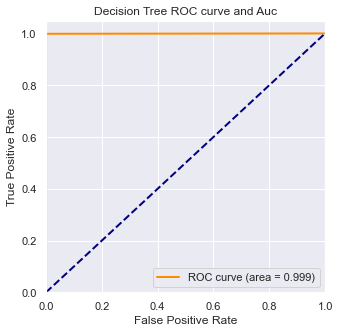

In [121]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_svmsmote_large = dt_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_dt_svmsmote_large,tpr_dt_svmsmote_large,threshold_dt_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_dt_svmsmote_large) ###计算真正率和假正率
roc_auc_dt_svmsmote_large = auc(fpr_dt_svmsmote_large,tpr_dt_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_svmsmote_large, tpr_dt_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Random Forest

In [122]:
rf_svmsmote_large = RandomForestClassifier(random_state=42)

In [123]:
rf_auc_svmsmote_large, rf_rec_svmsmote_large, rf_model_svmsmote_large = model_svmsmote_large_train(rf_svmsmote_large, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[692   0]
 [  0 750]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       692
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 1.0
Random Forest Classifier Recall  Validation Data
Recall 1.0


In [124]:
## train set
rf_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
rf_svmsmote_large_prediction_train = rf_svmsmote_large.predict(X_train_svmsmote_large)
print("Random Forest Conclusion for SVM SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, rf_svmsmote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=rf_svmsmote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=rf_svmsmote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=rf_svmsmote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, rf_svmsmote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SVM SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [125]:
## test set
rf_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
rf_svmsmote_large_prediction = rf_svmsmote_large.predict(X_test_svmsmote_large)
print("Random Forest Conclusion for SVM SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, rf_svmsmote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=rf_svmsmote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=rf_svmsmote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=rf_svmsmote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, rf_svmsmote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SVM SMOTE Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [126]:
## validation set
y_valpred_svmsmote_large = rf_svmsmote_large.predict(X_val_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

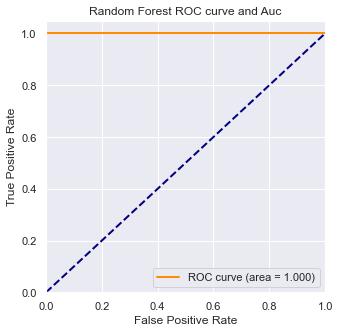

In [127]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_svmsmote_large = rf_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_svmsmote_large,tpr_rf_svmsmote_large,threshold_rf_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_rf_svmsmote_large) ###计算真正率和假正率
roc_auc_rf_svmsmote_large = auc(fpr_rf_svmsmote_large,tpr_rf_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_svmsmote_large, tpr_rf_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [128]:
rf_y_train_pred_svmsmote_large=rf_svmsmote_large.predict(X_train_svmsmote_large)
print('Accuracy score of train data :{}'.format(rf_svmsmote_large.score(X_train_svmsmote_large,y_train_svmsmote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_svmsmote_large, rf_y_train_pred_svmsmote_large)))

rf_y_val_pred_svmsmote_large=rf_svmsmote_large.predict(X_val_svmsmote_large)
print('Accuracy score of validation  data :{}'.format(rf_svmsmote_large.score(X_val_svmsmote_large,y_val_svmsmote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_svmsmote_large, rf_y_val_pred_svmsmote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :1.0
validation data f1_Score:1.0


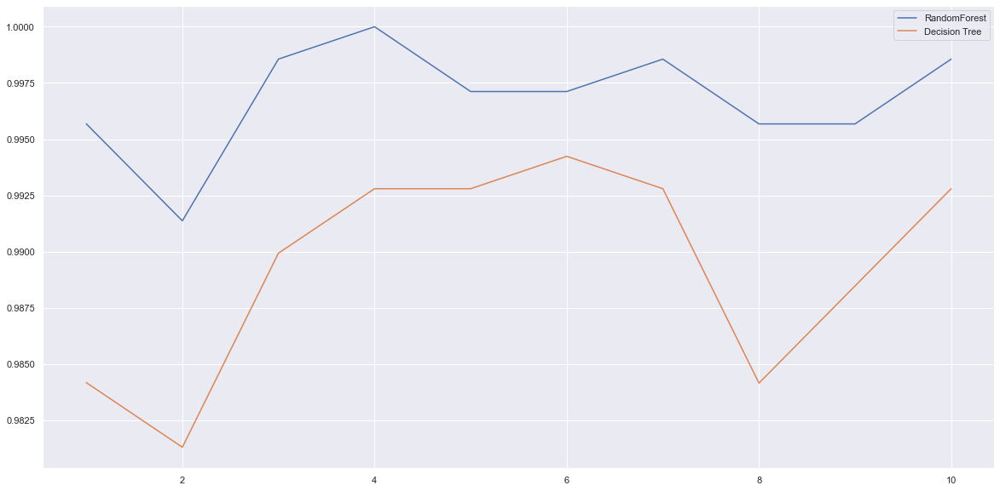

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s_svmsmote_large=cross_val_score(rf_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s_svmsmote_large=cross_val_score(dt_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s_svmsmote_large,label="RandomForest")
plt.plot(range(1,11),clf_s_svmsmote_large,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

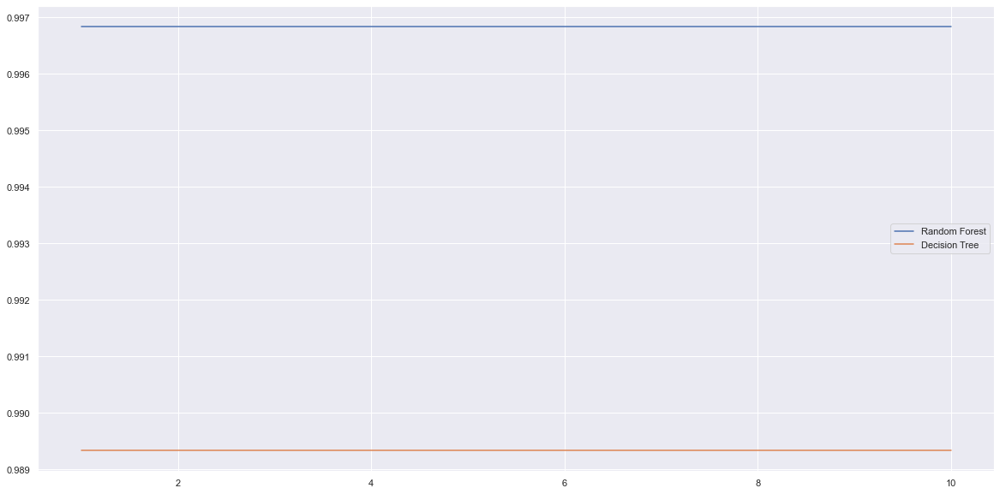

In [ ]:
rfc_l_svmsmote_large = []
clf_l_svmsmote_large = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s_svmsmote_large = cross_val_score(rf_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10).mean()
  rfc_l_svmsmote_large.append(rfc_s_svmsmote_large)
  # clf = DecisionTreeClassifier()
  clf_s_svmsmote_large = cross_val_score(dt_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10).mean()
  clf_l_svmsmote_large.append(clf_s_svmsmote_large)
 
plt.plot(range(1,11),rfc_l_svmsmote_large,label = "Random Forest")
plt.plot(range(1,11),clf_l_svmsmote_large,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred_svmsmote_large=rf_svmsmote_large.predict(X_train_svmsmote_large)
print('Accuracy score of train data :{}'.format(rf_svmsmote_large.score(X_train_svmsmote_large,y_train_svmsmote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_svmsmote_large, rf_y_train_pred_svmsmote_large)))

rf_y_val_pred_svmsmote_large=rf_svmsmote_large.predict(X_val_svmsmote_large)
print('Accuracy score of validation  data :{}'.format(rf_svmsmote_large.score(X_val_svmsmote_large,y_val_svmsmote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_svmsmote_large, rf_y_val_pred_svmsmote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9951060358890701
validation data f1_Score:0.9952456418383517


### Grid Search

In [129]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,15,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_svmsmote_large = GridSearchCV(rf_svmsmote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_svmsmote_large = rf_gs_svmsmote_large.predict(X_test_svmsmote_large)

Fitting 3 folds for each of 1080 candidates, totalling 3240 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s

[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.2s

In [130]:
rf_gs_svmsmote_large.best_estimator_

RandomForestClassifier(max_depth=10, min_samples_split=5, n_estimators=6,
                       random_state=42)

In [132]:
rf_gs_svmsmote_large_model=RandomForestClassifier(max_depth=10, min_samples_split=5, n_estimators=6,
                       random_state=42)
rf_gs_svmsmote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_gs_svmsmote_large = rf_gs_svmsmote_large_model.predict(X_test_svmsmote_large)

In [133]:
print("Grid Search Validation Data")
cm_svmsmote_large = confusion_matrix(y_test_svmsmote_large, y_pred_gs_svmsmote_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_svmsmote_large)
print('-----------------------')
cr_svmsmote_large = classification_report(y_test_svmsmote_large, y_pred_gs_svmsmote_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_svmsmote_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_svmsmote_large = roc_auc_score(y_test_svmsmote_large, y_pred_gs_svmsmote_large)       
print("AUC Score " + str(auc_svmsmote_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_svmsmote_large = recall_score(y_test_svmsmote_large, y_pred_gs_svmsmote_large)
print("Recall "+ str(rec_svmsmote_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[691   1]
 [  1 749]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       692
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9986107899807323
Grid Search Recall  Validation Data
Recall 0.9986666666666667


In [134]:
## train set
rf_gs_svmsmote_large_model.fit(X_train_svmsmote_large,y_train_svmsmote_large)
y_pred_gs_svmsmote_large_train = rf_gs_svmsmote_large_model.predict(X_train_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, y_pred_gs_svmsmote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=y_pred_gs_svmsmote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=y_pred_gs_svmsmote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=y_pred_gs_svmsmote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, y_pred_gs_svmsmote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [135]:
## test set
y_pred_gs_svmsmote_large = rf_gs_svmsmote_large_model.predict(X_test_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, y_pred_gs_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=y_pred_gs_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=y_pred_gs_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=y_pred_gs_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, y_pred_gs_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of test set
Precision:          0.9986666666666667
F1-Score:           0.9986107899807322
Accuracy Scores:    0.9986130374479889
Recall Scores:      0.9986107899807322
Sensitivity:        0.9986666666666667
Specificity:        0.9985549132947977


In [136]:
## validation set
y_valpred_gs_svmsmote_large = rf_gs_svmsmote_large_model.predict(X_val_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_gs_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_gs_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_gs_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_gs_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_gs_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of val set
Precision:          0.9984126984126984
F1-Score:           0.9991837479285772
Accuracy Scores:    0.9991843393148451
Recall Scores:      0.9991624790619765
Sensitivity:        1.0
Specificity:        0.998324958123953


<Figure size 1440x720 with 0 Axes>

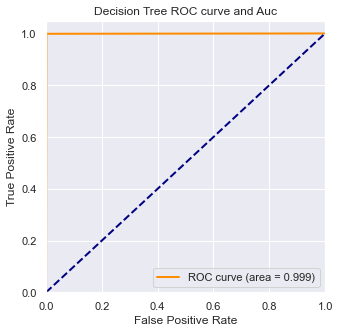

In [137]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_svmsmote_large = rf_gs_svmsmote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_svmsmote_large,tpr_rf_gs_svmsmote_large,threshold_rf_gs_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_rf_gs_svmsmote_large) ###计算真正率和假正率
roc_auc_rf_gs_svmsmote_large = auc(fpr_rf_gs_svmsmote_large,tpr_rf_gs_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_svmsmote_large, tpr_rf_gs_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [138]:
rf_random_svmsmote_large = RandomizedSearchCV(rf_svmsmote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_svmsmote_large = rf_random_svmsmote_large.predict(X_test_svmsmote_large)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=8; total time=   0.2s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=8; total time=   0.2s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=8; total time=   0.2s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=13; total time=   0.4s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=13; total t

In [139]:
rf_random_svmsmote_large.best_estimator_

RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                       n_estimators=14, random_state=42)

In [140]:
rf_random_svmsmote_large_model= RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                       n_estimators=14, random_state=42)
rf_random_svmsmote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_random_svmsmote_large = rf_random_svmsmote_large_model.predict(X_test_svmsmote_large)

In [141]:
print("Grid Search Validation Data")
cm_svmsmote_large = confusion_matrix(y_test_svmsmote_large, y_pred_random_svmsmote_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_svmsmote_large)
print('-----------------------')
cr_svmsmote_large = classification_report(y_test_svmsmote_large, y_pred_random_svmsmote_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_svmsmote_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_svmsmote_large = roc_auc_score(y_test_svmsmote_large, y_pred_random_svmsmote_large)       
print("AUC Score " + str(auc_svmsmote_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_svmsmote_large = recall_score(y_test_svmsmote_large, y_pred_random_svmsmote_large)
print("Recall "+ str(rec_svmsmote_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[692   0]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       692
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Grid Search AUC Score  Validation Data
AUC Score 1.0
Grid Search Recall  Validation Data
Recall 1.0


In [142]:
## train set
rf_random_svmsmote_large_model.fit(X_train_svmsmote_large,y_train_svmsmote_large)
y_pred_random_svmsmote_large_train = rf_random_svmsmote_large_model.predict(X_train_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, y_pred_random_svmsmote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=y_pred_random_svmsmote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=y_pred_random_svmsmote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=y_pred_random_svmsmote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, y_pred_random_svmsmote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [143]:
## test set
y_pred_random_svmsmote_large = rf_random_svmsmote_large_model.predict(X_test_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, y_pred_random_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=y_pred_random_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=y_pred_random_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=y_pred_random_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, y_pred_random_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [144]:
## validation set
y_valpred_random_svmsmote_large = rf_random_svmsmote_large_model.predict(X_val_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_random_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_random_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_random_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_random_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_random_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

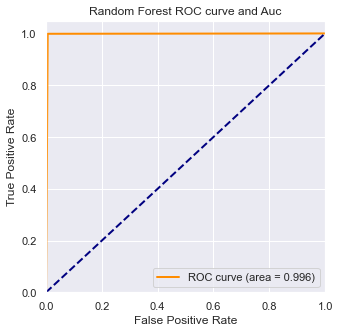

In [251]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random_svmsmote_large = rf_random_smote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_random_svmsmote_large,tpr_rf_random_svmsmote_large,threshold_rf_random_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_rf_random_svmsmote_large) ###计算真正率和假正率
roc_auc_rf_random_svmsmote_large = auc(fpr_rf_random_svmsmote_large,tpr_rf_random_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random_svmsmote_large, tpr_rf_random_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [145]:
perm_svmsmote_large = PermutationImportance(rf_random_svmsmote_large, random_state=42).fit(X_test_svmsmote_large, y_test_svmsmote_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_svmsmote_large, feature_names = X_test_svmsmote_large.columns.values)# Display the weights of each features

Weight,Feature
0.0216 ± 0.0059,OAE1.4
0.0184 ± 0.0059,OAE2
0.0031 ± 0.0021,OAE2.8
0.0024 ± 0.0024,f(226.0000)
0.0019 ± 0.0016,TPP
0.0014 ± 0.0015,f(5993.2283)
0.0007 ± 0.0000,f(1887.7486)
0.0004 ± 0.0007,f(2593.6791)
0.0004 ± 0.0007,f(500.0000)
0.0003 ± 0.0007,f(865.5366)


Lets check the same with Random Forest classifier

In [146]:
perm_svmsmote_large = PermutationImportance(rf_random_svmsmote_large, random_state=101).fit(X_test_svmsmote_large, y_test_svmsmote_large)
eli5.show_weights(perm_svmsmote_large, feature_names = X_test_svmsmote_large.columns.values)

Weight,Feature
0.0207 ± 0.0062,OAE1.4
0.0190 ± 0.0036,OAE2
0.0026 ± 0.0014,f(226.0000)
0.0024 ± 0.0019,OAE2.8
0.0021 ± 0.0009,f(5993.2283)
0.0015 ± 0.0020,TPP
0.0011 ± 0.0014,OAE4
0.0006 ± 0.0006,f(2593.6791)
0.0004 ± 0.0007,f(458.5020)
0.0004 ± 0.0007,OAE1


Conclusion: The columns in the green are the most important features.

### Shap
Lets see how the columns impact a single record of data

In [147]:
row_to_show = 20                       # The row for which we want to check the SHAP explanations
data_to_predict_svmsmote_large = X_test_svmsmote_large.iloc[row_to_show]
#data_to_predict

In [148]:
data_to_preddict_array_svmsmote_large = data_to_predict_svmsmote_large.values.reshape(1,-1)
# Prediction probability on the row of the data
dt_model_svmsmote_large.predict_proba(data_to_preddict_array_svmsmote_large) 

array([[1., 0.]])

In [149]:
dt_model_svmsmote_large.predict(data_to_preddict_array_svmsmote_large)       # Predicted output

array([0])

In [150]:
y_test_svmsmote_large.iloc[row_to_show]

OverallPoF    0
Name: 20, dtype: int64

In [151]:
# Object that can calculate Shap values
explainer_svmsmote_large = shap.TreeExplainer(dt_model_svmsmote_large)                         # SHAP Tree Explainer

# Calculate the shap values
shap_values_svmsmote_large = explainer_svmsmote_large.shap_values(data_to_predict_svmsmote_large) # SHAP explanations

In [152]:
shap.initjs()
shap.force_plot(explainer_svmsmote_large.expected_value[1], shap_values_svmsmote_large[1], data_to_predict_svmsmote_large)

#### Each feature affects the results

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 8.11 µs


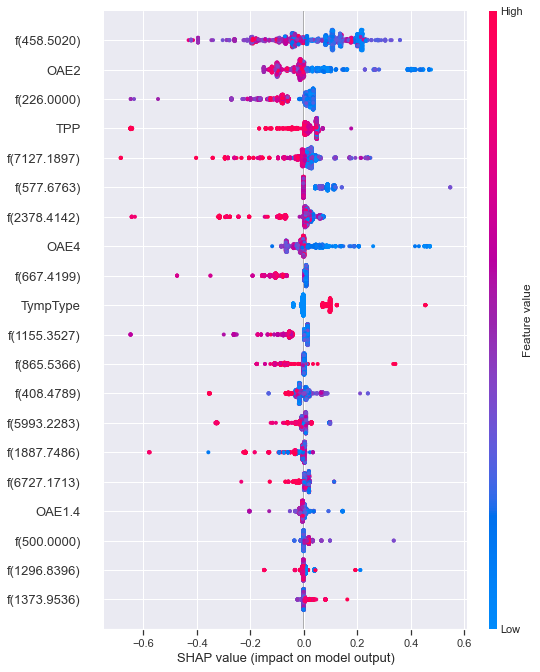

In [153]:
%time
# samples = X_train
samples_svmsmote_large = X_test_svmsmote_large

explainer_svmsmote_large = shap.TreeExplainer(rf_random_svmsmote_large.best_estimator_[1])
shap_values_svmsmote_large = explainer_svmsmote_large.shap_values(samples_svmsmote_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_svmsmote_large[1], samples_svmsmote_large)

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

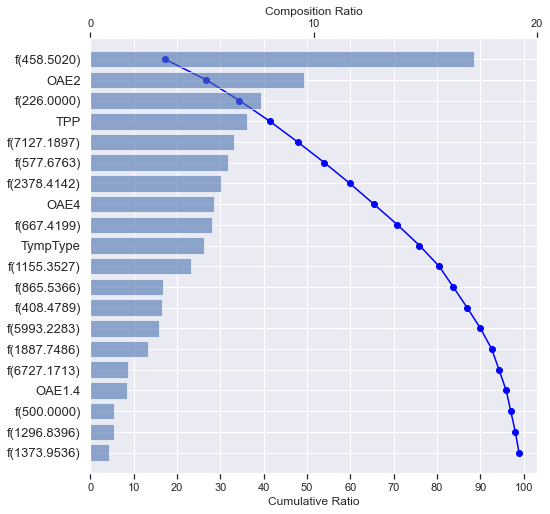

In [156]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_svmsmote_large[1], samples_svmsmote_large)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 50% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。

In [157]:
shap.force_plot(explainer_svmsmote_large.expected_value[1], shap_values_svmsmote_large[1], samples_svmsmote_large)

### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer_smote = lime.lime_tabular.LimeTabularExplainer(X_train_smote.values,
                                                         feature_names=X_train_smote.columns.values.tolist(),
                                                         mode='classification',class_names='Attack')

In [ ]:
lime_expln1_smote=explainer_smote.explain_instance(X_test_smote.iloc[1],dt_model_smote.predict_proba,num_features=X_test_smote.shape[1], top_labels = 1)
lime_expln1_smote.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


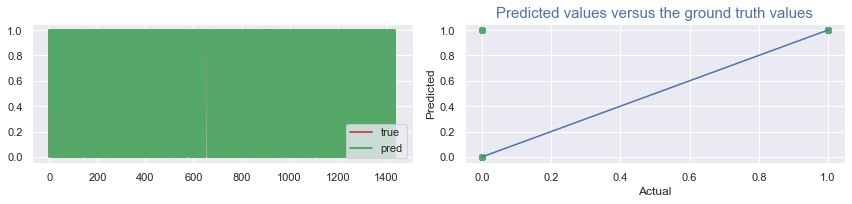

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_svmsmote_large))
pred_plot(np.ravel(y_test_svmsmote_large), np.ravel(y_pred_random_svmsmote_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_svmsmote_large), np.ravel(y_test_svmsmote_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_svmsmote_large), np.ravel(y_pred_random_svmsmote_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - Adasyn dataset

### Training Model Function

In [78]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, recall_score
def model_train(model_adasyn_large, name):
    model_adasyn_large.fit(X_train_adasyn_large, y_train_adasyn_large)                                          # Fitting the model_adasyn_large
    y_pred_adasyn_large = model_adasyn_large.predict(X_test_adasyn_large)                                       # Making prediction from the trained model_adasyn_large
    cm_adasyn_large = confusion_matrix(y_test_adasyn_large, y_pred_adasyn_large)                               
    print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
    print(cm_adasyn_large)
    print('-----------------------')
    print('-----------------------')
    cr_adasyn_large = classification_report(y_test_adasyn_large, y_pred_adasyn_large)
    print(name +" Classification Report " +" Validation Data")           # Displaying the Classification Report
    print(cr_adasyn_large)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc_adasyn_large = roc_auc_score(y_test_adasyn_large, y_pred_adasyn_large)       
    print("AUC Score " + str(auc_adasyn_large))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec_adasyn_large = recall_score(y_test_adasyn_large, y_pred_adasyn_large)
    print("Recall "+ str(rec_adasyn_large))                                           # Displaying the Recall score
    return auc_adasyn_large, rec_adasyn_large, model_adasyn_large

### Decision Tree

In [79]:
dt_adasyn_large = DecisionTreeClassifier(random_state=42)

In [80]:
dt_auc_adasyn_large, dt_rec_adasyn_large, dt_model_adasyn_large = model_train(dt_adasyn_large, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[747   3]
 [  0 751]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       751

    accuracy                           1.00      1501
   macro avg       1.00      1.00      1.00      1501
weighted avg       1.00      1.00      1.00      1501

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.998
Decision Tree Recall  Validation Data
Recall 1.0


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

In [81]:
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
dt_prediction_adasyn_large = dt_adasyn_large.predict(X_test_adasyn_large)
accuracy_dt_adasyn_large = accuracy_score(dt_prediction_adasyn_large,y_test_adasyn_large)
cm_dt_adasyn_large = confusion_matrix(dt_prediction_adasyn_large,y_test_adasyn_large)
prfs_dt_adasyn_large = precision_recall_fscore_support(dt_prediction_adasyn_large,y_test_adasyn_large)
print('Accuracy: ',accuracy_dt_adasyn_large)
print('\n')
print('Confusion Matrix: ',cm_dt_adasyn_large)
print('\n')
print('Precision: ', prfs_dt_adasyn_large[0])
print('Recall:    ', prfs_dt_adasyn_large[1])
print('Fscore:    ', prfs_dt_adasyn_large[2])
print('Support:   ', prfs_dt_adasyn_large[3])

Accuracy:  0.9980013324450366


Confusion Matrix:  [[747   0]
 [  3 751]]


Precision:  [0.996 1.   ]
Recall:     [1.         0.99602122]
Fscore:     [0.99799599 0.99800664]
Support:    [747 754]


In [82]:
dt_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_dt_adasyn_large = dt_adasyn_large.predict(X_test_adasyn_large)

In [83]:
## train set
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
dt_adasyn_large_prediction_train = dt_adasyn_large.predict(X_train_adasyn_large)
print("Decision Tree Conclusion for Adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, dt_adasyn_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=dt_adasyn_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=dt_adasyn_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=dt_adasyn_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, dt_adasyn_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Adasyn Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [84]:
## test set
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
dt_adasyn_large_prediction = dt_adasyn_large.predict(X_test_adasyn_large)
print("Decision Tree Conclusion for adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, dt_adasyn_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=dt_adasyn_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=dt_adasyn_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=dt_adasyn_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, dt_adasyn_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for adasyn Dataset of test set
Precision:          0.9960212201591512
F1-Score:           0.9980013182511202
Accuracy Scores:    0.9980013324450366
Recall Scores:      0.998
Sensitivity:        1.0
Specificity:        0.996


In [85]:
## validation set
y_valpred_dt_adasyn_large = dt_adasyn_large.predict(X_val_adasyn_large)
print("Decision Tree Conclusion for Adasyn Dataset of val set")
print('Precision:         ',precision_score(y_val_adasyn_large, y_valpred_dt_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_val_adasyn_large, y_pred=y_valpred_dt_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_adasyn_large, y_pred=y_valpred_dt_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_val_adasyn_large,y_pred=y_valpred_dt_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_adasyn_large, y_valpred_dt_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Adasyn Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

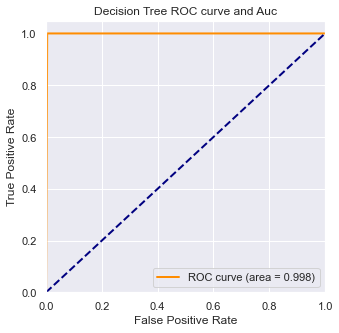

In [86]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_adasyn_large = dt_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_dt_adasyn_large,tpr_dt_adasyn_large,threshold_dt_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_dt_adasyn_large) ###计算真正率和假正率
roc_auc_dt_adasyn_large = auc(fpr_dt_adasyn_large,tpr_dt_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_adasyn_large, tpr_dt_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

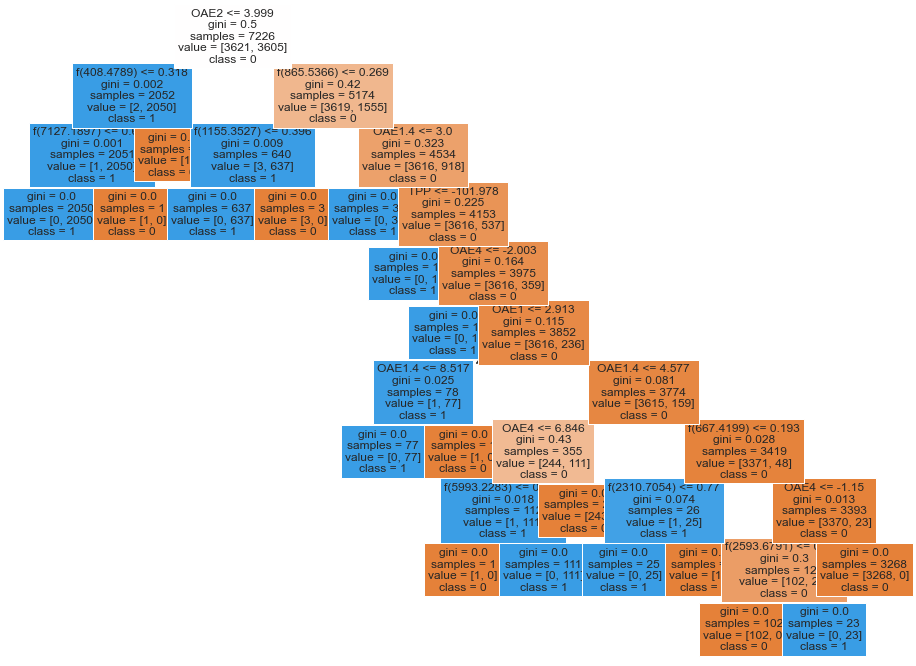

In [87]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
predictions_dt_adasyn_large = dt_adasyn_large.predict(X_test_adasyn_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_adasyn_large = plot_tree(dt_adasyn_large, feature_names=X_train_adasyn_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

### Random Forest

In [88]:
rf_adasyn_large = RandomForestClassifier(random_state=42)

In [90]:
rf_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_rf_adasyn_large = rf_adasyn_large.predict(X_test_adasyn_large)

In [91]:
## train set
rf_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
rf_adasyn_large_prediction_train = rf_adasyn_large.predict(X_train_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, rf_adasyn_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=rf_adasyn_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=rf_adasyn_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=rf_adasyn_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, rf_adasyn_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [92]:
## test set
rf_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
rf_adasyn_large_prediction = rf_adasyn_large.predict(X_test_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, rf_adasyn_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=rf_adasyn_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=rf_adasyn_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=rf_adasyn_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, rf_adasyn_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of test set
Precision:          0.9986702127659575
F1-Score:           0.9993337762988588
Accuracy Scores:    0.9993337774816788
Recall Scores:      0.9993333333333334
Sensitivity:        1.0
Specificity:        0.9986666666666667


In [93]:
## validation set
y_valpred_rf_adasyn_large = rf_adasyn_large.predict(X_val_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of val set")
print('Precision:         ',precision_score(y_val_adasyn_large, y_valpred_rf_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_val_adasyn_large, y_pred=y_valpred_rf_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_adasyn_large, y_pred=y_valpred_rf_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_val_adasyn_large,y_pred=y_valpred_rf_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_adasyn_large, y_valpred_rf_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

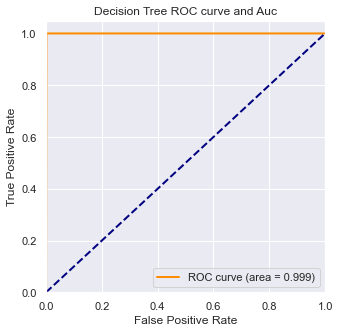

In [94]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_adasyn_large = rf_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_rf_adasyn_large,tpr_rf_adasyn_large,threshold_rf_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_rf_adasyn_large) ###计算真正率和假正率
roc_auc_rf_adasyn_large = auc(fpr_rf_adasyn_large,tpr_rf_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_adasyn_large, tpr_rf_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [95]:
rf_y_train_pred_adasyn_large=rf_adasyn_large.predict(X_train_adasyn_large)
print('Accuracy score of train data :{}'.format(rf_adasyn_large.score(X_train_adasyn_large,y_train_adasyn_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_adasyn_large, rf_y_train_pred_adasyn_large)))

rf_y_val_pred_adasyn_large=rf_adasyn_large.predict(X_val_adasyn_large)
print('Accuracy score of validation  data :{}'.format(rf_adasyn_large.score(X_val_adasyn_large,y_val_adasyn_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_adasyn_large, rf_y_val_pred_adasyn_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :1.0
validation data f1_Score:1.0


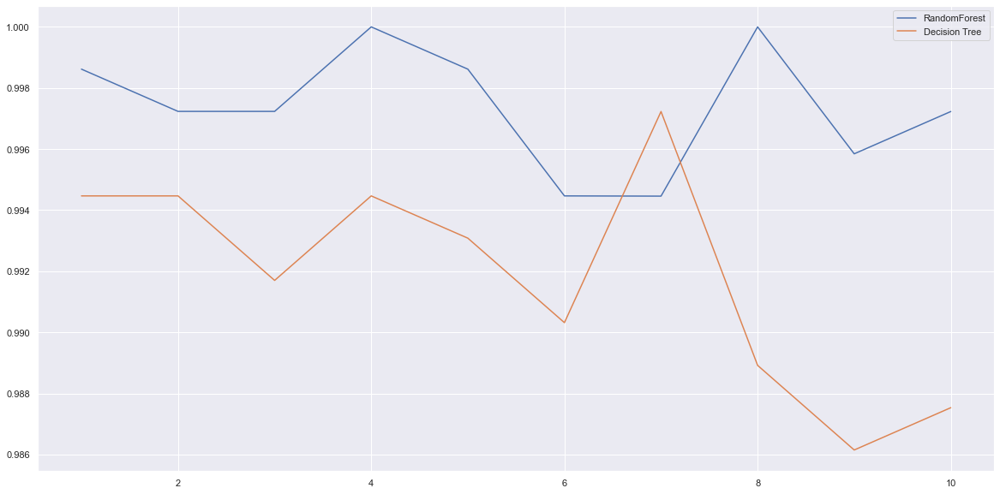

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s_adasyn_large=cross_val_score(rf_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s_adasyn_large=cross_val_score(dt_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s_adasyn_large,label="RandomForest")
plt.plot(range(1,11),clf_s_adasyn_large,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

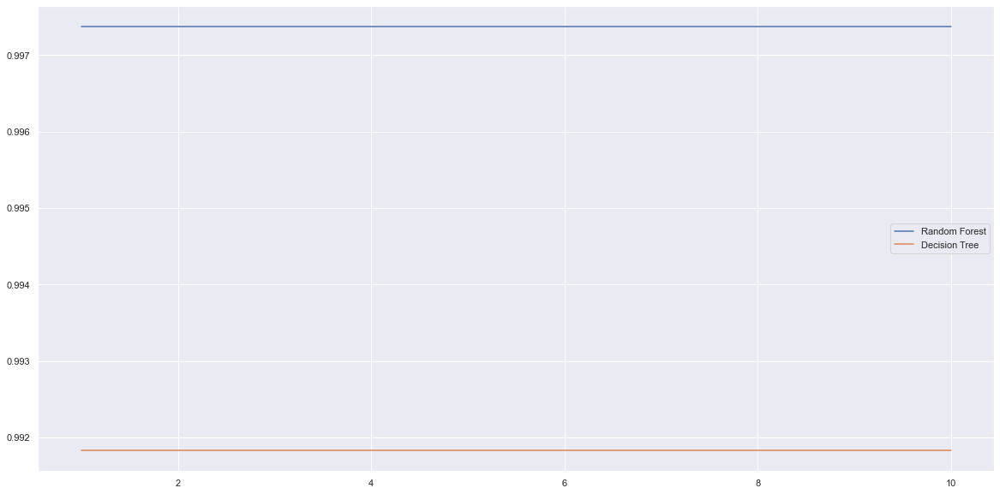

In [ ]:
rfc_l_adasyn_large = []
clf_l_adasyn_large = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s_adasyn_large = cross_val_score(rf_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10).mean()
  rfc_l_adasyn_large.append(rfc_s_adasyn_large)
  # clf = DecisionTreeClassifier()
  clf_s_adasyn_large = cross_val_score(dt_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10).mean()
  clf_l_adasyn_large.append(clf_s_adasyn_large)
 
plt.plot(range(1,11),rfc_l_adasyn_large,label = "Random Forest")
plt.plot(range(1,11),clf_l_adasyn_large,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred_adasyn_large=rf_adasyn_large.predict(X_train_adasyn_large)
print('Accuracy score of train data :{}'.format(rf_adasyn_large.score(X_train_adasyn_large,y_train_adasyn_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_adasyn_large, rf_y_train_pred_adasyn_large)))

rf_y_val_pred_adasyn_large=rf_adasyn_large.predict(X_val_adasyn_large)
print('Accuracy score of validation  data :{}'.format(rf_adasyn_large.score(X_val_adasyn_large,y_val_adasyn_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_adasyn_large, rf_y_val_pred_adasyn_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9952978056426333
validation data f1_Score:0.9953703703703703


### Grid Search

In [97]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,15,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_adasyn_large = GridSearchCV(rf_adasyn_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_adasyn_large = rf_gs_adasyn_large.predict(X_test_adasyn_large)

Fitting 3 folds for each of 1080 candidates, totalling 3240 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.3s

In [98]:
rf_gs_adasyn_large.best_estimator_

RandomForestClassifier(max_depth=10, n_estimators=10, random_state=42)

In [99]:
rf_gs_adasyn_large_model = RandomForestClassifier(max_depth=10, n_estimators=10, random_state=42)
rf_gs_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_gs_adasyn_large = rf_gs_adasyn_large_model.predict(X_test_adasyn_large)

In [100]:
print("Grid Search Validation Data")
cm_adasyn_large = confusion_matrix(y_test_adasyn_large, y_pred_gs_adasyn_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_adasyn_large)
print('-----------------------')
cr_adasyn_large = classification_report(y_test_adasyn_large, y_pred_gs_adasyn_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_adasyn_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_adasyn_large = roc_auc_score(y_test_adasyn_large, y_pred_gs_adasyn_large)       
print("AUC Score " + str(auc_adasyn_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_adasyn_large = recall_score(y_test_adasyn_large, y_pred_gs_adasyn_large)
print("Recall "+ str(rec_adasyn_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[749   1]
 [  0 751]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       751

    accuracy                           1.00      1501
   macro avg       1.00      1.00      1.00      1501
weighted avg       1.00      1.00      1.00      1501

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9993333333333334
Grid Search Recall  Validation Data
Recall 1.0


In [101]:
## train set
rf_gs_adasyn_large_model.fit(X_train_adasyn_large,y_train_adasyn_large)
y_pred_gs_adasyn_large_train = rf_gs_adasyn_large_model.predict(X_train_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, y_pred_gs_adasyn_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=y_pred_gs_adasyn_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=y_pred_gs_adasyn_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=y_pred_gs_adasyn_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, y_pred_gs_adasyn_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [102]:
## test set
y_pred_gs_adasyn_large = rf_gs_adasyn_large_model.predict(X_test_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, y_pred_gs_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=y_pred_gs_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=y_pred_gs_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=y_pred_gs_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, y_pred_gs_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of test set
Precision:          0.9986702127659575
F1-Score:           0.9993337762988588
Accuracy Scores:    0.9993337774816788
Recall Scores:      0.9993333333333334
Sensitivity:        1.0
Specificity:        0.9986666666666667


In [103]:
## validation set
y_valpred_gs_smote_large = rf_gs_smote_large_model.predict(X_val_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_gs_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_gs_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_gs_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

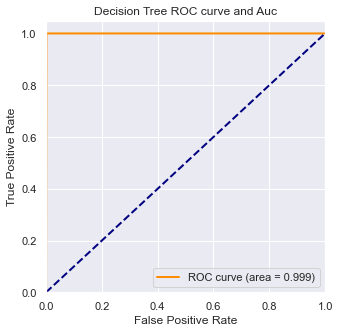

In [104]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_adasyn_large = rf_gs_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_adasyn_large,tpr_rf_gs_adasyn_large,threshold_rf_gs_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_rf_gs_adasyn_large) ###计算真正率和假正率
roc_auc_rf_gs_adasyn_large = auc(fpr_rf_gs_adasyn_large,tpr_rf_gs_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_adasyn_large, tpr_rf_gs_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [105]:
rf_random_adasyn_large = RandomizedSearchCV(rf_adasyn_large, random_grid, cv = 4, n_jobs=-1, verbose=2)

rf_random_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_adasyn_large = rf_random_adasyn_large.predict(X_test_adasyn_large)

Fitting 4 folds for each of 10 candidates, totalling 40 fits
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=10; total time=   0.4s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=10; total time=   0.4s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=10; total time=   0.5s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=10; total time=   0.5s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=17; total time=   0.6s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=17; total time=   0.6s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=17; total time=   0.6s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=17; total 

In [113]:
rf_random_adasyn_large.best_estimator_

RandomForestClassifier(max_depth=20, min_samples_split=5, n_estimators=10,
                       random_state=42)

In [107]:
# rf_random_adasyn_large_model=RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_split=10,
#                        n_estimators=10, random_state=42)
rf_random_adasyn_large_model=RandomForestClassifier(max_depth=20, min_samples_split=5, n_estimators=10,
                       random_state=42)
# rf_random_adasyn_large_model=RandomForestClassifier(max_depth=20, min_samples_leaf=2, min_samples_split=10,
#                        n_estimators=11, random_state=42)
rf_random_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_random_adasyn_large = rf_random_adasyn_large_model.predict(X_test_adasyn_large)

In [108]:
print("Grid Search Validation Data")
cm_adasyn_large = confusion_matrix(y_test_adasyn_large, y_pred_random_adasyn_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_adasyn_large)
print('-----------------------')
cr_adasyn_large = classification_report(y_test_adasyn_large, y_pred_random_adasyn_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_adasyn_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_adasyn_large = roc_auc_score(y_test_adasyn_large, y_pred_random_adasyn_large)       
print("AUC Score " + str(auc_adasyn_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_adasyn_large = recall_score(y_test_adasyn_large, y_pred_random_adasyn_large)
print("Recall "+ str(rec_adasyn_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[749   1]
 [  0 751]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       751

    accuracy                           1.00      1501
   macro avg       1.00      1.00      1.00      1501
weighted avg       1.00      1.00      1.00      1501

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9993333333333334
Grid Search Recall  Validation Data
Recall 1.0


In [109]:
## train set
rf_random_adasyn_large_model.fit(X_train_adasyn_large,y_train_adasyn_large)
y_pred_random_adasyn_large_train = rf_random_adasyn_large_model.predict(X_train_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, y_pred_random_adasyn_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=y_pred_random_adasyn_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=y_pred_random_adasyn_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=y_pred_random_adasyn_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, y_pred_random_adasyn_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [110]:
## test set
y_pred_random_adasyn_large = rf_random_adasyn_large_model.predict(X_test_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, y_pred_random_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=y_pred_random_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=y_pred_random_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=y_pred_random_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, y_pred_random_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of test set
Precision:          0.9986702127659575
F1-Score:           0.9993337762988588
Accuracy Scores:    0.9993337774816788
Recall Scores:      0.9993333333333334
Sensitivity:        1.0
Specificity:        0.9986666666666667


In [111]:
## validation set
y_valpred_random_adasyn_large = rf_random_adasyn_large_model.predict(X_val_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of val set")
print('Precision:         ',precision_score(y_val_adasyn_large, y_valpred_random_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_val_adasyn_large, y_pred=y_valpred_random_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_adasyn_large, y_pred=y_valpred_random_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_val_adasyn_large,y_pred=y_valpred_random_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_adasyn_large, y_valpred_random_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

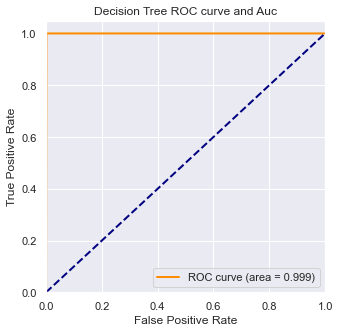

In [112]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random_adasyn_large = rf_random_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_rf_random_adasyn_large,tpr_rf_random_adasyn_large,threshold_rf_random_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_rf_random_adasyn_large) ###计算真正率和假正率
roc_auc_rf_random_adasyn_large = auc(fpr_rf_random_adasyn_large,tpr_rf_random_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random_adasyn_large, tpr_rf_random_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [158]:
perm_adasyn_large = PermutationImportance(rf_random_adasyn_large_model, random_state=42).fit(X_test_adasyn_large, y_test_adasyn_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_adasyn_large, feature_names = X_test_adasyn_large.columns.values)# Display the weights of each features

Weight,Feature
0.0922 ± 0.0105,OAE2
0.0516 ± 0.0082,OAE1.4
0.0071 ± 0.0027,TPP
0.0017 ± 0.0018,OAE1
0.0015 ± 0.0010,f(1155.3527)
0.0013 ± 0.0015,OAE2.8
0.0011 ± 0.0020,OAE4
0.0004 ± 0.0011,f(667.4199)
0 ± 0.0000,f(408.4789)
0 ± 0.0000,f(2593.6791)


Lets check the same with Random Forest classifier

In [159]:
perm_adasyn_large = PermutationImportance(rf_random_adasyn_large_model, random_state=101).fit(X_test_adasyn_large, y_test_adasyn_large)
eli5.show_weights(perm_adasyn_large, feature_names = X_test_adasyn_large.columns.values)

Weight,Feature
0.0947 ± 0.0054,OAE2
0.0546 ± 0.0074,OAE1.4
0.0079 ± 0.0028,TPP
0.0020 ± 0.0019,OAE2.8
0.0017 ± 0.0023,OAE4
0.0016 ± 0.0011,f(1155.3527)
0.0016 ± 0.0020,OAE1
0 ± 0.0000,f(408.4789)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(2310.7054)


Conclusion: The columns in the green are the most important features.

### Shap
Lets see how the columns impact a single record of data

In [160]:
row_to_show = 20                                                                # The row for which we want to check the SHAP explanations
data_to_predict_adasyn_large = X_test_adasyn_large.iloc[row_to_show]
#data_to_predict

In [161]:
data_to_preddict_array_adasyn_large = data_to_predict_adasyn_large.values.reshape(1,-1)
# Prediction probability on the row of the data
dt_model_adasyn_large.predict_proba(data_to_preddict_array_adasyn_large) 

array([[1., 0.]])

In [162]:
dt_model_adasyn_large.predict(data_to_preddict_array_adasyn_large)       # Predicted output

array([0])

In [163]:
y_test_adasyn_large.iloc[row_to_show]

OverallPoF    0
Name: 20, dtype: int64

In [164]:
# Object that can calculate Shap values
explainer_adasyn_large = shap.TreeExplainer(dt_model_adasyn_large)                         # SHAP Tree Explainer

# Calculate the shap values
shap_values_adasyn_large = explainer_adasyn_large.shap_values(data_to_predict_adasyn_large) # SHAP explanations

In [165]:
shap.initjs()
shap.force_plot(explainer_adasyn_large.expected_value[1], shap_values_adasyn_large[1], data_to_predict_adasyn_large)

#### Each feature affects the results

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 3.81 µs


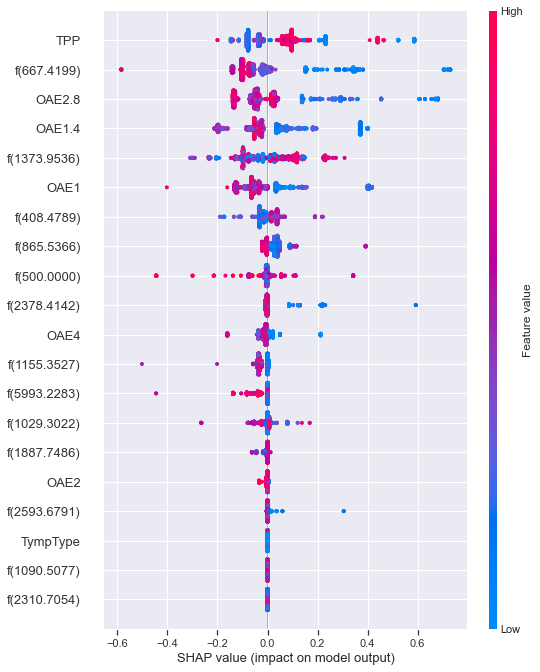

In [166]:
%time
# samples = X_train
samples_adasyn_large = X_test_adasyn_large

explainer_adasyn_large = shap.TreeExplainer(rf_random_adasyn_large.best_estimator_[1])
shap_values_adasyn_large = explainer_adasyn_large.shap_values(samples_adasyn_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_adasyn_large[1], samples_adasyn_large)

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

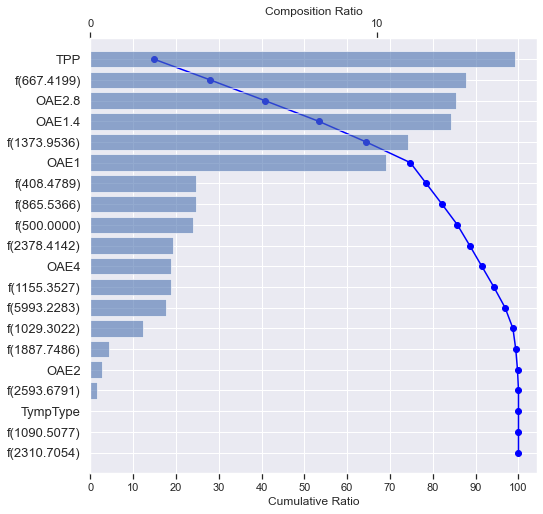

In [167]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_adasyn_large[1], samples_adasyn_large)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 50% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。

In [ ]:
shap.force_plot(explainer_adasyn_large.expected_value[1], shap_values_adasyn_large[1], samples_adasyn_large)

### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer_smote = lime.lime_tabular.LimeTabularExplainer(X_train_smote.values,
                                                         feature_names=X_train_smote.columns.values.tolist(),
                                                         mode='classification',class_names='Attack')

In [ ]:
lime_expln1_smote=explainer_smote.explain_instance(X_test_smote.iloc[1],dt_model_smote.predict_proba,num_features=X_test_smote.shape[1], top_labels = 1)
lime_expln1_smote.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


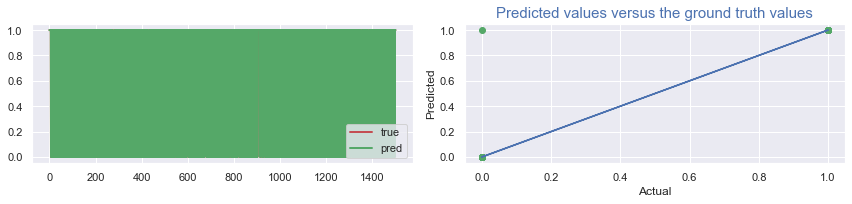

In [170]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_adasyn_large))
pred_plot(np.ravel(y_test_adasyn_large), np.ravel(y_pred_random_adasyn_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_adasyn_large), np.ravel(y_test_adasyn_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_adasyn_large), np.ravel(y_pred_adasyn_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

In [ ]:
clf_over = DecisionTreeClassifier(random_state=42)   # decision tree instantiation
rfc_over = RandomForestClassifier(random_state=42)   # Random forest instantiation

# Training data set
clf_over = clf_over.fit(X_train_over,y_train_over)
rfc_over = rfc_over.fit(X_train_over,np.ravel(y_train_over))

score_c_over = clf_over.score(X_test_over,y_test_over)
score_r_over=rfc_over.score(X_test_over,y_test_over)
print("single tree:{}".format(score_c_over))
print("randon forest:{}".format(score_r_over))

single tree:0.9836065573770492
randon forest:0.9836065573770492


### GridSearch

In [ ]:
clf_l_over = []
rfc_l_over = []
# Cross-validation: This is a method of dividing the data set into n parts, taking each part in turn as a test set and each n-1 part as a training set, and training the model several times to observe the stability of the model
for i in range(10):
    # Random forest cross-validation
    rfc_over = RandomForestClassifier(n_estimators=25)
    rfc_s_over = cross_val_score(rfc_over, X_train_over, np.ravel(y_train_over), cv=10).mean()
    rfc_l_over.append(rfc_s_over)
    # Decision tree cross-validation
    clf_over = DecisionTreeClassifier()
    clf_s_over = cross_val_score(clf_over, X_train_over, np.ravel(y_train_over), cv=10).mean()
    clf_l_over.append(clf_s_over)

plt.plot(range(1, 11), rfc_l_over, label="Random Forest")
plt.plot(range(1, 11), clf_l_over, label="Decision Tree")
plt.legend()
plt.show()

n_estimators

0.9941176470588236 0


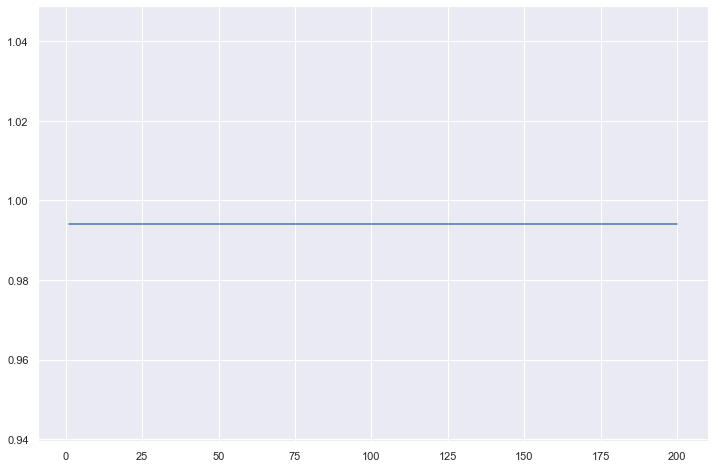

In [ ]:
rfc_over = RandomForestClassifier(n_estimators=25,random_state=1)
superpa_over = []
for i in range(200):
    rfc_over = RandomForestClassifier(n_estimators=i+1,n_jobs=-1,random_state=1)
    rfc_s_over = cross_val_score(rfc,X_train_over,np.ravel(y_train_over),cv=10).mean()
    superpa_over.append(rfc_s_over)
print(max(superpa_over),superpa_over.index(max(superpa_over)))
plt.figure(figsize=[12,8])
plt.plot(range(1,201),superpa_over)
plt.show()


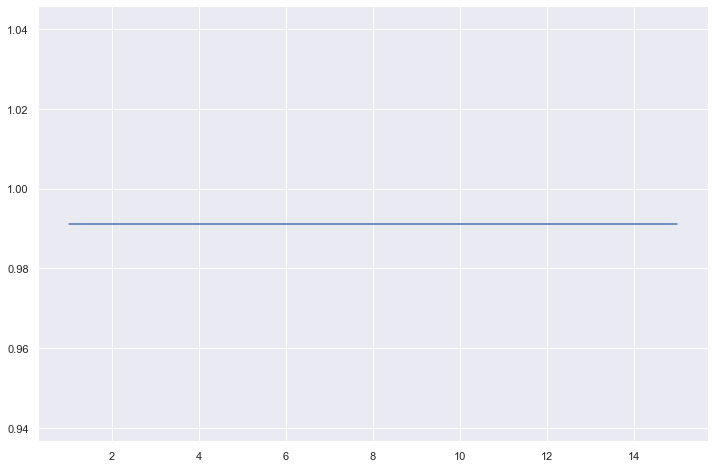

In [ ]:
idx_over = []
for j in range(15):
    rfc_1_over = RandomForestClassifier(n_estimators=25,max_features=j+1,random_state=1)
    rfc_1_s_over = cross_val_score(rfc_over,X_train_over,np.ravel(y_train_over),cv=10).mean()
    idx_over.append(rfc_1_s_over)
plt.figure(figsize=(12,8))
plt.plot(range(1,16),idx_over)
plt.show()

In [ ]:
from sklearn.tree import plot_tree

In [ ]:
rf_classifier = grid_rf.best_estimator_

In [ ]:
rf_pred = rf_classifier.predict(X_test)
accuracy_score(rf_pred, y_test)

1.0

In [ ]:
plot_cm(y_test, rf_pred)

NameError: name 'plot_cm' is not defined

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

params = {'max_leaf_nodes': list(range(2, 100)), 'min_samples_split': [2, 3, 4]}
grid_search_cv = GridSearchCV(DecisionTreeClassifier(random_state=42), params, verbose=1, cv=3)

grid_search_cv.fit(X_train, y_train)

Fitting 3 folds for each of 294 candidates, totalling 882 fits


GridSearchCV(cv=3, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                            13, 14, 15, 16, 17, 18, 19, 20, 21,
                                            22, 23, 24, 25, 26, 27, 28, 29, 30,
                                            31, ...],
                         'min_samples_split': [2, 3, 4]},
             verbose=1)

In [ ]:
grid_search_cv.best_estimator_

DecisionTreeClassifier(max_leaf_nodes=3, random_state=42)

In [ ]:
# importing Decision Tree Classifier via sklean

from sklearn.tree import DecisionTreeClassifier

dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dtree.fit(X_train,y_train)
predictions = dtree.predict(X_test)

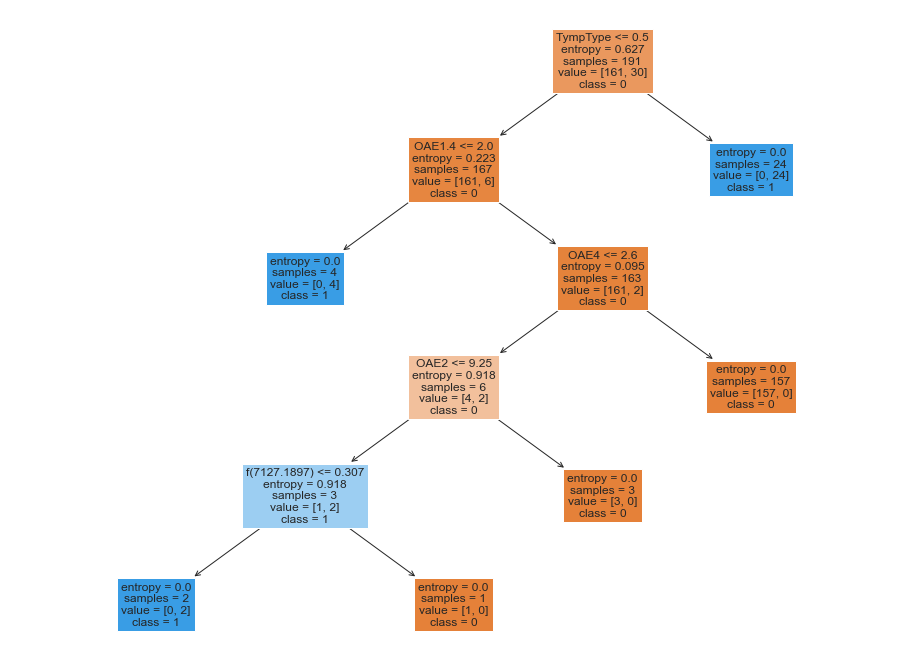

In [ ]:
# visualising the decision tree diagram

from sklearn.tree import plot_tree

import matplotlib.pyplot as plt
fig = plt.figure(figsize=(16,12))
a = plot_tree(dtree, feature_names=X_train.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [ ]:
X_train.columns

Index(['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4',
       'f(408.4789)', 'f(2593.6791)', 'f(2378.4142)', 'f(2310.7054)',
       'f(7127.1897)', 'f(865.5366)', 'f(6727.1713)', 'f(226.0000)',
       'f(458.5020)', 'f(500.0000)', 'f(1029.3022)', 'f(5993.2283)',
       'f(1887.7486)', 'f(1373.9536)', 'f(667.4199)', 'f(2747.9073)',
       'f(1296.8396)', 'f(577.6763)', 'f(1155.3527)', 'f(1090.5077)'],
      dtype='object')

In [ ]:
# importing Decision Tree Classifier via sklean

from sklearn.tree import DecisionTreeClassifier

dtree_over = DecisionTreeClassifier(criterion='entropy',max_depth=5)
dtree_over.fit(X_train_over,y_train_over)
predictions = dtree_over.predict(X_test_over)

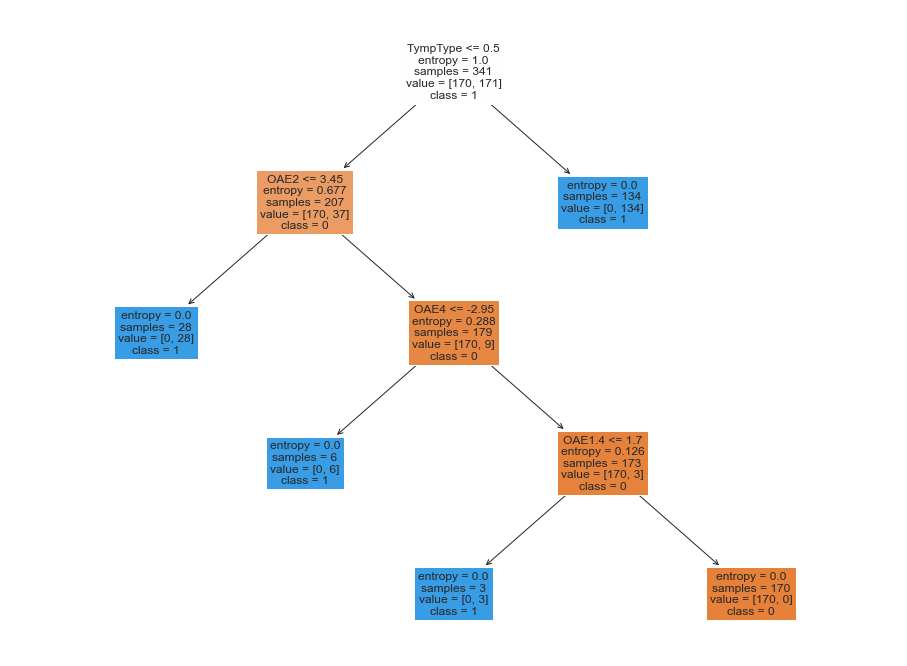

In [ ]:
fig_over = plt.figure(figsize=(16,12))
a_over = plot_tree(dtree_over, feature_names=X_train_over.columns, fontsize=12, filled=True, class_names=['0', '1'])